In [ ]:
pip install neo4j

Note: you may need to restart the kernel to use updated packages.


In [ ]:
from neo4j import GraphDatabase

In [1]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

In [ ]:
#-----------------------------1. Data Collecting-------------------------
def extract_painting_influence_data(db_conn, output_file):
    # link to neo4j
    uri = db_conn['uri']
    username = db_conn['user']
    password = db_conn['password']

    driver = GraphDatabase.driver(uri, auth=(username, password))

    # search nodes
    query = """
    MATCH (n:ART)
    WHERE n.instance_of = 'Q3305213'
    OPTIONAL MATCH (n)-[:influenced_by]->(p:ART) WHERE p.instance_of = 'Q3305213'
    OPTIONAL MATCH (n)-[:influenced_by]->(a:KNOWLEDGE) WHERE ANY(occ IN a.occupation WHERE occ = 'Q1028181')
    RETURN n.wid AS wid, n.label AS label, p.wid AS influenced_by_painting, a.wid AS influenced_by_painter, n.creator AS creator, n.image AS image, n.movement AS movement, n.genre AS genre, n.time_period AS time
    """

    with driver.session() as session:
        result = session.run(query)

        # convert into dataset
        data = []
        for record in result:
            # Only keep the first creator for reducing complexity
            data.append({
                'wid': record['wid'],
                'label': record['label'],
                'influenced_by_painting': record['influenced_by_painting'],
                'influenced_by_painter': record['influenced_by_painter'],
                'creator': record['creator'],
                'image': record['image'],
                'movement':record['movement'],
                'genre':record['genre'],
                'time':record['time']
            })

    # close link
    driver.close()

    # save dataset
    df = pd.DataFrame(data)
    df.to_csv(output_file, index=False)
    print(f"Data has been saved to {output_file}")

db_conn = {
    'uri': 'bolt://localhost:7687',
    'user': 'neo4j',
    'password': 'quanquan'
}

output_file = 'painting.csv'
extract_painting_influence_data(db_conn, output_file)

Data has been saved to painting.csv


In [ ]:
# check dataset
df = pd.read_csv('painting.csv')

df.describe(include='all')

/var/folders/z6/h5q2k85x7ks4gpfns4r8jxq40000gn/T/ipykernel_33085/2931754849.py:2: DtypeWarning: Columns (2,3) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv('painting.csv')


,wid,label,influenced_by_painting,influenced_by_painter,creator,image,movement,genre,time
count,237817,191897,10,14,205050,237817,6384,136256,576
unique,237813,151289,10,14,24066,237431,380,788,50
top,Q737062,Self-portrait,Q3814745,Q297,Q41406,https://upload.wikimedia.org/wikipedia/commons...,Q2352880,Q134307,Q37853
freq,3,797,1,1,1484,8,366,50834,168


In [ ]:
# Keep only the first creator to reduce complexity
df['creator'] = df['creator'].apply(lambda x: x.split(',')[0] if isinstance(x, str) and len(x.split(',')) > 1 else x)

df.head

<bound method NDFrame.head of                wid                          label influenced_by_painting  \
0           Q24011  Mademoiselle Caroline Rivière                    NaN   
1           Q25986         Susanna and the Elders                    NaN   
2           Q28722               The Stonebreaker                    NaN   
3           Q40432                 The Horse Fair                    NaN   
4           Q45585               The Starry Night                    NaN   
...            ...                            ...                    ...   
237812  Q115902479                            NaN                    NaN   
237813  Q115902505                            NaN                    NaN   
237814  Q115902513                            NaN                    NaN   
237815  Q115902515                            NaN                    NaN   
237816  Q115907437                Among the Waves                    NaN   

       influenced_by_painter   creator  \
0              

In [ ]:
# collect the influence relationships between painters
db_conn = {
    'uri': 'bolt://localhost:7687',
    'user': 'neo4j',
    'password': 'quanquan'
}
def extract_painter_influence_data(db_conn):
    driver = GraphDatabase.driver(db_conn['uri'], auth=(db_conn['user'], db_conn['password']))

    query = """
    MATCH (a:KNOWLEDGE)-[r:influenced_by]->(b:KNOWLEDGE)
    WHERE ANY(occ IN a.occupation WHERE occ = 'Q1028181') AND ANY(occ IN b.occupation WHERE occ = 'Q1028181')
    RETURN a.wid AS a_wid, a.label AS a_label, COLLECT(b.wid) AS b_wid_list, COLLECT(b.label) AS b_label_list
    """

    with driver.session() as session:
        painter_influence_result = session.run(query)

        painter_influence_data = []
        for record in painter_influence_result:
            painter_influence_data.append({
                'a_wid': record['a_wid'],
                'a_label': record['a_label'],
                'b_wid_list': record['b_wid_list'],
                'b_label_list': record['b_label_list']
            })

    driver.close()

    painter_influence_df = pd.DataFrame(painter_influence_data)

    #rename variables
    painter_influence_df.rename(columns={
        'a_wid': 'painter',
        'a_label': 'painter_label',
        'b_wid_list': 'creator_influenced_by',
        'b_label_list': 'creator_influenced_by_label'
    }, inplace=True)

    return painter_influence_df

df2 = extract_painter_influence_data(db_conn)

In [ ]:
#check
print(df2.head())
len(df2)

   painter         painter_label creator_influenced_by  \
0    Q5580        Albrecht Dürer    [Q262771, Q927350]   
1    Q5594  Antonello da Messina            [Q2273503]   
2   Q44032          Egon Schiele              [Q34661]   
3  Q134741      Camille Pissarro            [Q4992964]   
4  Q150679      Anthony van Dyck               [Q5599]   

              creator_influenced_by_label  
0  [Michael Wolgemut, Jacopo de' Barbari]  
1            [Niccolò Antonio Colantonio]  
2                          [Gustav Klimt]  
3                          [Fritz Melbye]  
4                     [Peter Paul Rubens]  


581

In [ ]:
#merge 2 datasets
merged_df = pd.merge(df, df2[['painter', 'creator_influenced_by']], left_on='creator', right_on='painter', how='left')
merged_df = merged_df.drop(columns=['painter'])

print(merged_df.head())

      wid                          label influenced_by_painting  \
0  Q24011  Mademoiselle Caroline Rivière                    NaN   
1  Q25986         Susanna and the Elders                    NaN   
2  Q28722               The Stonebreaker                    NaN   
3  Q40432                 The Horse Fair                    NaN   
4  Q45585               The Starry Night                    NaN   

  influenced_by_painter  creator  \
0                   NaN   Q23380   
1                   NaN  Q153746   
2                   NaN  Q977276   
3                   NaN  Q241732   
4                   NaN    Q5582   

                                               image  movement  \
0  https://upload.wikimedia.org/wikipedia/commons...    Q14378   
1  ['https://upload.wikimedia.org/wikipedia/commo...       NaN   
2  https://upload.wikimedia.org/wikipedia/commons...       NaN   
3  https://upload.wikimedia.org/wikipedia/commons...  Q2642826   
4  https://upload.wikimedia.org/wikipedia/commons.

In [ ]:
# collect painters information
db_conn = {
    'uri': 'bolt://localhost:7687',
    'user': 'neo4j',
    'password': 'quanquan'
}
def extract_painter_data(db_conn):
    driver = GraphDatabase.driver(db_conn['uri'], auth=(db_conn['user'], db_conn['password']))

    query = """
    MATCH (b:KNOWLEDGE) WHERE ANY(occ IN b.occupation WHERE occ = 'Q1028181')
    RETURN b.wid AS painter_wid, b.label AS painter_label
"""


    with driver.session() as session:
        result = session.run(query)

        # convert into dataset
        data = []
        for record in result:
            data.append({
                'painter_wid': record['painter_wid'],
                'painter_label': record['painter_label']
            })

    # close link
    driver.close()

    # save dataset
    movement_df = pd.DataFrame(data)
    return movement_df

df_p = extract_painter_data(db_conn)
print(df_p.head())

  painter_wid           painter_label
0        Q207          George W. Bush
1        Q297         Diego Velázquez
2       Q2677              Wilhelm II
3       Q5233  François-Édouard Picot
4       Q5571        Andrea del Sarto


In [ ]:
# merge painter information
merged_df['creator'] = merged_df['creator'].astype(str)
df_p['painter_wid'] = df_p['painter_wid'].astype(str)

merged_df = pd.merge(merged_df, df_p[['painter_wid', 'painter_label']], left_on='creator', right_on='painter_wid', how='left')

# replace 'creator' with 'painter_label'
merged_df['creator'] = merged_df['painter_label']

# delete 'painter' and 'painter_label'
merged_df = merged_df.drop(columns=['painter_wid', 'painter_label'])

print(merged_df.head())

      wid                          label influenced_by_painting  \
0  Q24011  Mademoiselle Caroline Rivière                    NaN   
1  Q25986         Susanna and the Elders                    NaN   
2  Q28722               The Stonebreaker                    NaN   
3  Q40432                 The Horse Fair                    NaN   
4  Q45585               The Starry Night                    NaN   

  influenced_by_painter                        creator  \
0                   NaN  Jean Auguste Dominique Ingres   
1                   NaN             Albrecht Altdorfer   
2                   NaN                   Henry Wallis   
3                   NaN                   Rosa Bonheur   
4                   NaN               Vincent van Gogh   

                                               image  movement  \
0  https://upload.wikimedia.org/wikipedia/commons...    Q14378   
1  ['https://upload.wikimedia.org/wikipedia/commo...       NaN   
2  https://upload.wikimedia.org/wikipedia/commons.

In [ ]:
print(merged_df.count())

wid                       237817
label                     191897
influenced_by_painting        10
influenced_by_painter         14
creator                   201662
image                     237817
movement                    6384
genre                     136256
time                         576
creator_influenced_by      20768
dtype: int64


In [ ]:
# collect movement data
db_conn = {
    'uri': 'bolt://localhost:7687',
    'user': 'neo4j',
    'password': 'quanquan'
}
def extract_movement_data(db_conn):
    driver = GraphDatabase.driver(db_conn['uri'], auth=(db_conn['user'], db_conn['password']))

    query = """
    MATCH (a:ART)-[r:movement]->(b:KNOWLEDGE) WHERE a.instance_of = 'Q3305213'
    RETURN b.wid AS m_wid, b.label AS m_label
    """

    with driver.session() as session:
        result = session.run(query)

        # convert into dataset
        data = []
        for record in result:
            data.append({
                'm_wid': record['m_wid'],
                'm_label': record['m_label']
            })

    # close link
    driver.close()

    # save dataset
    movement_df = pd.DataFrame(data)
    return movement_df

df3 = extract_movement_data(db_conn)
print(df3.head())

      m_wid              m_label
0    Q14378        neoclassicism
1  Q2642826              Realism
2   Q166713   post-impressionism
3  Q1404472  Italian Renaissance
4   Q131808            mannerism


In [ ]:
# remove duplicates
df3 = df3.drop_duplicates(subset=['m_wid'])

In [ ]:
#merge 2 datasets
merged_df1 = pd.merge(merged_df, df3, left_on='movement', right_on='m_wid', how='left')
merged_df1 = merged_df1.drop(columns=['m_wid'])

print(merged_df1.head())

      wid                          label influenced_by_painting  \
0  Q24011  Mademoiselle Caroline Rivière                    NaN   
1  Q25986         Susanna and the Elders                    NaN   
2  Q28722               The Stonebreaker                    NaN   
3  Q40432                 The Horse Fair                    NaN   
4  Q45585               The Starry Night                    NaN   

  influenced_by_painter                        creator  \
0                   NaN  Jean Auguste Dominique Ingres   
1                   NaN             Albrecht Altdorfer   
2                   NaN                   Henry Wallis   
3                   NaN                   Rosa Bonheur   
4                   NaN               Vincent van Gogh   

                                               image  movement  \
0  https://upload.wikimedia.org/wikipedia/commons...    Q14378   
1  ['https://upload.wikimedia.org/wikipedia/commo...       NaN   
2  https://upload.wikimedia.org/wikipedia/commons.

In [ ]:
# collect genre data
db_conn = {
    'uri': 'bolt://localhost:7687',
    'user': 'neo4j',
    'password': 'quanquan'
}
def extract_genre_data(db_conn):
    driver = GraphDatabase.driver(db_conn['uri'], auth=(db_conn['user'], db_conn['password']))

    query = """
    MATCH (a:ART)-[r:genre]->(b:KNOWLEDGE) WHERE a.instance_of = 'Q3305213'
    RETURN b.wid AS g_wid, b.label AS g_label
    """

    with driver.session() as session:
        result = session.run(query)

        # convert into dataset
        data = []
        for record in result:
            data.append({
                'g_wid': record['g_wid'],
                'g_label': record['g_label']
            })

    # close link
    driver.close()

    # save dataset
    genre_df = pd.DataFrame(data)
    return genre_df

df4 = extract_genre_data(db_conn)
print(df4.head())

      g_wid        g_label
0   Q134307       portrait
1    Q40446           nude
2  Q2864737  religious art
3  Q1047337      genre art
4  Q1047337      genre art


In [ ]:
# remove duplicates
df4 = df4.drop_duplicates(subset=['g_wid'])

In [ ]:
#merge 2 datasets
merged_df2 = pd.merge(merged_df1, df4, left_on='genre', right_on='g_wid', how='left')
merged_df2 = merged_df2.drop(columns=['g_wid'])

print(merged_df2.head())

      wid                          label influenced_by_painting  \
0  Q24011  Mademoiselle Caroline Rivière                    NaN   
1  Q25986         Susanna and the Elders                    NaN   
2  Q28722               The Stonebreaker                    NaN   
3  Q40432                 The Horse Fair                    NaN   
4  Q45585               The Starry Night                    NaN   

  influenced_by_painter                        creator  \
0                   NaN  Jean Auguste Dominique Ingres   
1                   NaN             Albrecht Altdorfer   
2                   NaN                   Henry Wallis   
3                   NaN                   Rosa Bonheur   
4                   NaN               Vincent van Gogh   

                                               image  movement  \
0  https://upload.wikimedia.org/wikipedia/commons...    Q14378   
1  ['https://upload.wikimedia.org/wikipedia/commo...       NaN   
2  https://upload.wikimedia.org/wikipedia/commons.

In [ ]:
# make sure that genre are strings and remove unnecessary characters
merged_df1['genre'] = merged_df1['genre'].apply(lambda x: x.strip("[]").replace("'", "").split(", ") if pd.notna(x) else [])

# explode the multiple values in 'genre'
merged_df1 = merged_df1.explode('genre')

# remove blank
merged_df1['genre'] = merged_df1['genre'].str.strip()

# merge
merged_df2 = pd.merge(merged_df1, df4, left_on='genre', right_on='g_wid', how='left')

# delete 'g_wid'
merged_df2 = merged_df2.drop(columns=['g_wid'])

# Keep all columns and group by wid, merging multiple values ​​in the g_label column
merged_df2_grouped = merged_df2.groupby('wid').agg({
    'label': 'first',
    'influenced_by_painting': 'first',
    'influenced_by_painter': 'first',
    'creator': 'first',
    'image': 'first',
    'movement': 'first',
    'genre': lambda x: ', '.join(x.dropna()),
    'time': 'first',
    'creator_influenced_by': 'first',
    'm_label': 'first',
    'g_label': lambda x: ', '.join(x.dropna())
}).reset_index()

print(merged_df2_grouped.head())

          wid                                              label  \
0    Q1000128                                       The Bohemian   
1  Q100036761                                    Oxen in the Sea   
2  Q100052255  Aeneas saving his father anchises from the fir...   
3  Q100055151                                               None   
4  Q100058212                                               None   

  influenced_by_painting influenced_by_painter                     creator  \
0                   None                  None  William-Adolphe Bouguereau   
1                   None                  None             Joaquín Sorolla   
2                   None                  None   António Manuel da Fonseca   
3                   None                  None   António Manuel da Fonseca   
4                   None                  None   António Manuel da Fonseca   

                                               image movement  \
0  https://upload.wikimedia.org/wikipedia/commons...  Q18

In [ ]:
#-------------------------Data Preprocessing----------------------

# Simplyfy the variables for modelling
# As there are very few paintings influenced by others painters or paintings, but the influence between painters are more common in the dataset,
# any of these 3 conditions are considered as being influenced by other painters.

merged_df2_grouped['influenced'] = merged_df2_grouped[['influenced_by_painting', 'influenced_by_painter', 'creator_influenced_by']].notnull().any(axis=1)
print(merged_df2_grouped.head)

<bound method NDFrame.head of                wid                                              label  \
0         Q1000128                                       The Bohemian   
1       Q100036761                                    Oxen in the Sea   
2       Q100052255  Aeneas saving his father anchises from the fir...   
3       Q100055151                                               None   
4       Q100058212                                               None   
...            ...                                                ...   
237808   Q99981381                              The Marriage Proposal   
237809   Q99982256  Eskimos Coming towards the Boats in Shoalwater...   
237810   Q99982361                     Major-General Sir David Watson   
237811     Q999836                    Boats in the Harbour at Evening   
237812   Q99984175                       Polish Soldiers Forming Line   

       influenced_by_painting influenced_by_painter  \
0                        None         

In [ ]:
# Check the amounts of 'True' and 'False' in variable 'influenced'
influenced_counts = merged_df2_grouped['influenced'].value_counts()
print(influenced_counts)

influenced
False    217031
True      20782
Name: count, dtype: int64


In [ ]:
# Simplify the dataframe
df = merged_df2_grouped[['wid', 'label', 'influenced', 'image', 'creator', 'm_label', 'g_label']]
df = df.rename(columns={'m_label': 'movement'})
df = df.rename(columns={'g_label': 'genre'})

print(df.head())

          wid                                              label  influenced  \
0    Q1000128                                       The Bohemian       False   
1  Q100036761                                    Oxen in the Sea       False   
2  Q100052255  Aeneas saving his father anchises from the fir...       False   
3  Q100055151                                               None       False   
4  Q100058212                                               None       False   

                                               image  \
0  https://upload.wikimedia.org/wikipedia/commons...   
1  https://upload.wikimedia.org/wikipedia/commons...   
2  https://upload.wikimedia.org/wikipedia/commons...   
3  https://upload.wikimedia.org/wikipedia/commons...   
4  https://upload.wikimedia.org/wikipedia/commons...   

                      creator      movement                            genre  
0  William-Adolphe Bouguereau  academic art                        genre art  
1             Joaquín So

In [ ]:
# Keep only the first image link if there are multiple
df.loc[:, 'image'] = df['image'].apply(lambda x: x.strip('[]"\'').split(',')[0] if isinstance(x, str) else x)

print(df.head())

          wid                                              label  influenced  \
0    Q1000128                                       The Bohemian       False   
1  Q100036761                                    Oxen in the Sea       False   
2  Q100052255  Aeneas saving his father anchises from the fir...       False   
3  Q100055151                                               None       False   
4  Q100058212                                               None       False   

                                               image  \
0  https://upload.wikimedia.org/wikipedia/commons...   
1  https://upload.wikimedia.org/wikipedia/commons...   
2  https://upload.wikimedia.org/wikipedia/commons...   
3  https://upload.wikimedia.org/wikipedia/commons...   
4  https://upload.wikimedia.org/wikipedia/commons...   

                      creator      movement                            genre  
0  William-Adolphe Bouguereau  academic art                        genre art  
1             Joaquín So

In [ ]:
print(df.count())

wid           237813
label         191894
influenced    237813
image         237813
creator       201659
movement        5966
genre         237813
dtype: int64


In [ ]:
# delete the data that has empty 'creator' or 'movement' variable
df = df.dropna(subset=['creator', 'movement'])
print(df.head())

           wid                           label  influenced  \
0     Q1000128                    The Bohemian       False   
7   Q100139584                            None       False   
8   Q100141293    Paisaje de Vichy (Río Alier)       False   
9   Q100141699                            None       False   
17  Q100148966  Entry of Christ into Jerusalem       False   

                                                image  \
0   https://upload.wikimedia.org/wikipedia/commons...   
7   https://upload.wikimedia.org/wikipedia/commons...   
8   https://upload.wikimedia.org/wikipedia/commons...   
9   https://upload.wikimedia.org/wikipedia/commons...   
17  https://upload.wikimedia.org/wikipedia/commons...   

                        creator           movement          genre  
0    William-Adolphe Bouguereau       academic art      genre art  
7               Tomás Campuzano  Romantic painting  landscape art  
8         Ricardo Verdugo Landi  Romantic painting     marine art  
9   Juan de 

In [ ]:
# turn the strings in 'genre' into lists
df['genre'] = df['genre'].apply(lambda x: x.strip("[]").replace("'", "").split(", ") if isinstance(x, str) else x)

# explode multiple values in genre
df = df.explode('genre')

In [ ]:
print(df.count())

wid           6069
label         5363
influenced    6069
image         6069
creator       6069
movement      6069
genre         6069
dtype: int64


In [ ]:
influenced_counts = df['influenced'].value_counts()
print(influenced_counts)

influenced
False    5171
True      898
Name: count, dtype: int64


In [ ]:
print(df['movement'].value_counts())
print(df['genre'].value_counts())

movement
Dutch Golden Age painting    379
academic art                 375
Baroque                      343
Impressionism                338
Romanticism                  334
                            ... 
Scuola degli Albanesi          1
Bauhaus                        1
geometric abstraction          1
fantastic art                  1
hyperrealism                   1
Name: count, Length: 182, dtype: int64
genre
religious art                 1496
portrait                      1062
                               891
landscape art                  651
genre art                      497
                              ... 
Orphism                          1
expressionism                    1
elegy                            1
advertising postcard             1
Pre-Raphaelite Brotherhood       1
Name: count, Length: 81, dtype: int64


In [ ]:
# standardize movements
df['movement'] = df['movement'].str.replace(r'(?i).*baroque.*', 'Baroque', regex=True)
df['movement'] = df['movement'].str.replace(r'(?i).*renaissance.*', 'Renaissance', regex=True)
df['movement'] = df['movement'].str.replace(r'(?i).*impressionism.*', 'Impressionism', regex=True)
df['movement'] = df['movement'].str.replace(r'(?i).*expressionism.*', 'Expressionism', regex=True)
df['movement'] = df['movement'].str.replace(r'(?i).*romanticism.*', 'Romanticism', regex=True)
df['movement'] = df['movement'].str.replace(r'(?i).*realism.*', 'Realism', regex=True)

# 检查处理结果
print(df['movement'].value_counts())

movement
Renaissance                  781
Baroque                      498
Impressionism                474
Dutch Golden Age painting    379
academic art                 375
                            ... 
American scene painting        1
Yamato-e                       1
naive symbolism                1
Egyptian Revival               1
African American art           1
Name: count, Length: 150, dtype: int64


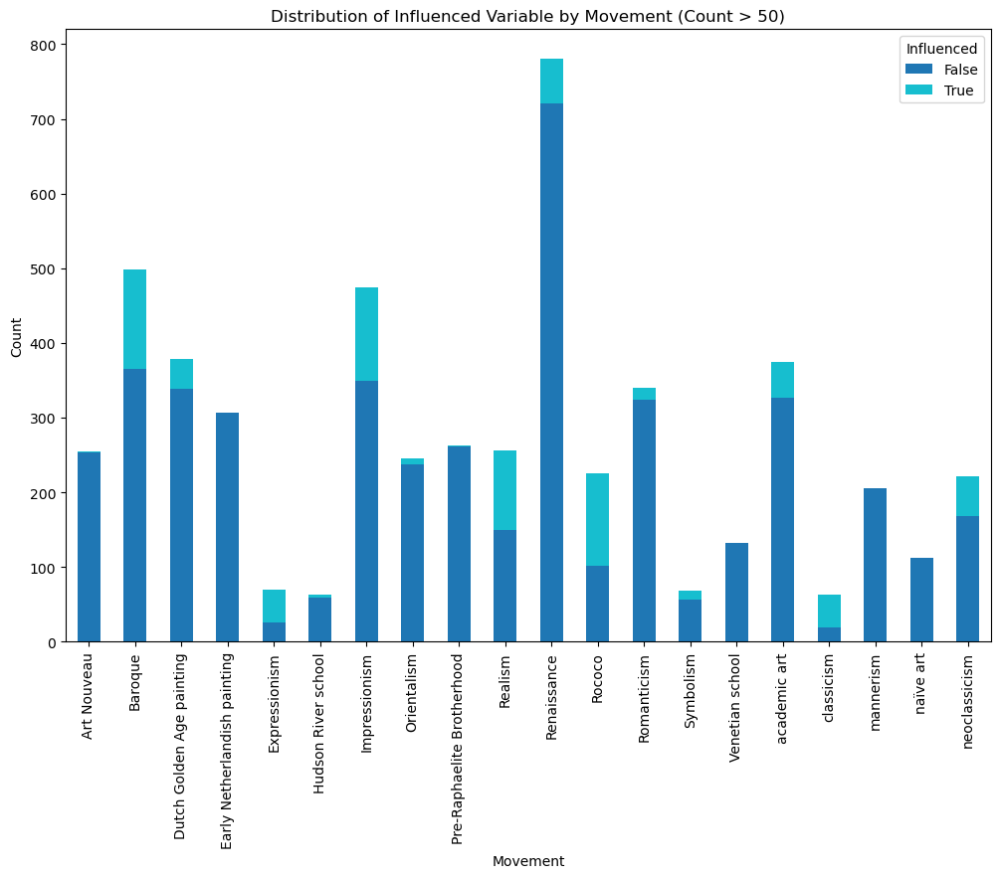

In [ ]:
#plot Distribution of Influenced Variable by Movement (Count > 50)
movement_counts = df['movement'].value_counts()

filtered_movements = movement_counts[movement_counts > 50].index
filtered_df = df[df['movement'].isin(filtered_movements)]

movement_influenced_distribution = pd.crosstab(filtered_df['movement'], filtered_df['influenced'])
movement_influenced_distribution.plot(kind='bar', stacked=True, figsize=(12, 8), colormap='tab10')

plt.title('Distribution of Influenced Variable by Movement (Count > 50)')
plt.xlabel('Movement')
plt.ylabel('Count')
plt.xticks(rotation=90)
plt.legend(title='Influenced')
plt.show()

In [ ]:
# select specific movements and genres for data balance and simplicity
target_movements = ['Baroque', 'Impressionism', 'Renaissance', 'Rococo', 'Realism', 'Classicism', 'Expressionism', 'neoclassicism', 'Dutch Golden Age painting']

filtered_df = df[df['movement'].isin(target_movements)]

sample_false = filtered_df[filtered_df['influenced'] == False].sample(n=600, random_state=42)
sample_true = filtered_df[filtered_df['influenced'] == True].sample(n=600, random_state=42)
balanced_sample = pd.concat([sample_false, sample_true])

print(balanced_sample['influenced'].value_counts())
print(balanced_sample['movement'].value_counts())
print(balanced_sample['genre'].value_counts())


influenced
False    600
True     600
Name: count, dtype: int64
movement
Renaissance                  237
Baroque                      204
Impressionism                204
Realism                      146
Rococo                       140
Dutch Golden Age painting    136
neoclassicism                 94
Expressionism                 39
Name: count, dtype: int64
genre
religious art             280
portrait                  262
                          130
genre art                 110
landscape art             109
mythological painting      62
still life                 48
nude                       42
self-portrait              26
history painting           24
allegory                   22
marine art                 14
animal art                 14
cityscape                   9
group portrait              8
equestrian portrait         7
floral painting             7
architectural painting      3
interior view               2
family portrait             2
vanitas                     2
fi

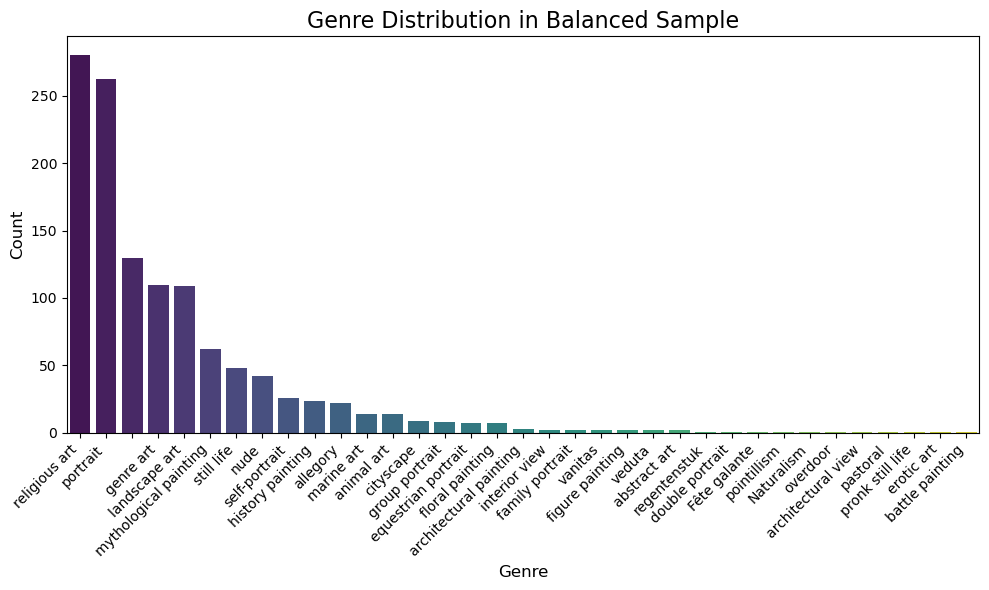

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# plot Genre Distribution in Balanced Sample
genre_counts = balanced_sample['genre'].value_counts()

plt.figure(figsize=(10, 6))
sns.barplot(x=genre_counts.index, y=genre_counts.values, palette="viridis")

plt.title('Genre Distribution in Balanced Sample', fontsize=16)
plt.xlabel('Genre', fontsize=12)
plt.ylabel('Count', fontsize=12)
plt.xticks(rotation=45, ha='right')

plt.tight_layout()
plt.show()

In [ ]:
# remove empty values
empty_genre = balanced_sample[balanced_sample['genre'].str.strip() == '']
print(f"Empty genre count: {len(empty_genre)}")

balanced_sample['genre'] = balanced_sample['genre'].replace(r'^\s*$', np.nan, regex=True)
balanced_sample = balanced_sample.dropna(subset=['genre'])

print(balanced_sample['genre'].value_counts())
print(balanced_sample['influenced'].value_counts())

Empty genre count: 0
genre
religious art             280
portrait                  262
genre art                 110
landscape art             109
mythological painting      62
still life                 48
nude                       42
self-portrait              26
history painting           24
allegory                   22
marine art                 14
animal art                 14
cityscape                   9
group portrait              8
floral painting             7
equestrian portrait         7
architectural painting      3
interior view               2
abstract art                2
vanitas                     2
family portrait             2
figure painting             2
veduta                      2
Fête galante                1
pointillism                 1
Naturalism                  1
double portrait             1
architectural view          1
pronk still life            1
overdoor                    1
pastoral                    1
erotic art                  1
regentenstuk 

In [ ]:
balanced_sample.to_csv('balanced_sample_dataset.csv', index=False)

In [ ]:
balanced_sample = pd.read_csv('balanced_sample_dataset.csv')

In [ ]:
# Checking if all the image url are valid
# As the population is too big, the checking is executed on the sample

In [32]:
import requests
from PIL import Image, UnidentifiedImageError
from io import BytesIO
from concurrent.futures import ThreadPoolExecutor

In [33]:
import warnings
from requests.packages.urllib3.exceptions import InsecureRequestWarning
from urllib.parse import quote
# 忽略不安全的请求警告
warnings.simplefilter('ignore', InsecureRequestWarning)

In [34]:
from PIL import Image

# remove image size limit
Image.MAX_IMAGE_PIXELS = None

In [35]:
import random

# Define alternative headers with User-Agent and Referer
headers = {
    'User-Agent': 'Mozilla/5.0 (Windows NT 10.0; Win64; x64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/114.0.5735.199 Safari/537.36',
    'Referer': 'https://www.bing.com/'
}

def is_valid_image(url):
    try:
        # Fetch the image with a timeout and skipping SSL verification
        response = requests.get(url, headers=headers, timeout=60, verify=False)

        # Raise an error if the status code is not 200
        response.raise_for_status()

        # Check if the content type is an image
        content_type = response.headers.get('Content-Type')
        if not content_type or not content_type.startswith('image'):
            print(f"Invalid content type: {content_type} for URL: {url}")
            return False

        # Attempt to open and verify the image
        img = Image.open(BytesIO(response.content))
        img.verify()

        # If the image opens and verifies successfully, it is valid
        return True

    except requests.exceptions.RequestException as e:
        print(f"Request failed for URL {url}: {e}")
        return False
    except UnidentifiedImageError:
        print(f"Unidentified image for URL: {url}")
        return False
    except OSError as e:
        print(f"OS error while processing image from URL {url}: {e}")
        return False


In [ ]:
valid_images = []
for url in balanced_sample['image']:
    if is_valid_image(url):
        valid_images.append(True)
    else:
        valid_images.append(False)

Request failed for URL https://upload.wikimedia.org/wikipedia/commons/4/4d/1602-3_Caravaggio%2CSupper_at_Emmaus_National_Gallery%2C_London.jpg': 404 Client Error: Not Found for url: https://upload.wikimedia.org/wikipedia/commons/4/4d/1602-3_Caravaggio%2CSupper_at_Emmaus_National_Gallery%2C_London.jpg'
Request failed for URL https://upload.wikimedia.org/wikipedia/commons/3/37/Turchi_Death_of_Adonis.jpg': 404 Client Error: Not Found for url: https://upload.wikimedia.org/wikipedia/commons/3/37/Turchi_Death_of_Adonis.jpg'
Request failed for URL https://upload.wikimedia.org/wikipedia/commons/5/51/Jan_Steen_023.jpg': 404 Client Error: Not Found for url: https://upload.wikimedia.org/wikipedia/commons/5/51/Jan_Steen_023.jpg'
Request failed for URL https://upload.wikimedia.org/wikipedia/commons/9/9f/Aleksander_Gierymski%2C_Piaskarze.jpg': 404 Client Error: Not Found for url: https://upload.wikimedia.org/wikipedia/commons/9/9f/Aleksander_Gierymski%2C_Piaskarze.jpg'
Request failed for URL https:/

In [ ]:
# remove invalid images
sample = balanced_sample[valid_images].copy()
print(sample['influenced'].value_counts())
# save as .csv
sample.to_csv('sample_dataset.csv', index=False)

influenced
False    506
True     497
Name: count, dtype: int64


In [ ]:
sample = pd.read_csv('sample_dataset.csv')

In [ ]:
from sklearn.utils import resample

# Separate the sample into two classes
sample_false = sample[sample['influenced'] == False]
sample_true = sample[sample['influenced'] == True]

# Resample each class to 400 samples
sample_false_resampled = resample(sample_false,
                                  replace=False,
                                  n_samples=400,
                                  random_state=42)

sample_true_resampled = resample(sample_true,
                                 replace=False,
                                 n_samples=400,
                                 random_state=42)

# Combine the resampled data
balanced_sample = pd.concat([sample_false_resampled, sample_true_resampled])

# Shuffle the balanced sample to ensure random order
sample = balanced_sample.sample(frac=1, random_state=42).reset_index(drop=True)

print(sample['influenced'].value_counts())
print(sample['genre'].value_counts())

influenced
True     400
False    400
Name: count, dtype: int64
genre
religious art             206
portrait                  198
landscape art              84
genre art                  77
mythological painting      47
still life                 35
nude                       32
self-portrait              19
history painting           18
allegory                   18
marine art                 11
animal art                 10
cityscape                   8
floral painting             7
group portrait              7
equestrian portrait         5
interior view               2
architectural painting      2
vanitas                     2
abstract art                2
veduta                      2
erotic art                  1
architectural view          1
figure painting             1
Naturalism                  1
Fête galante                1
pronk still life            1
regentenstuk                1
battle painting             1
Name: count, dtype: int64


In [ ]:
# standardize genres
small_sample_threshold = 10

sample['genre'] = sample['genre'].replace({'self-portrait': 'portrait', 'equestrian portrait': 'portrait'})
sample['genre'] = sample['genre'].replace({
    'cityscape': 'landscape art',
    'architectural painting': 'landscape art',
    'architectural view': 'landscape art',
    'interior view': 'landscape art'
})
sample['genre'] = sample['genre'].replace({'floral painting': 'still life', 'pronk still life': 'still life'})
sample['genre'] = sample['genre'].replace({'mythological painting': 'history painting'})
sample['genre'] = sample['genre'].replace({
    'animal art': 'nature',
    'marine art': 'nature',
    'allegory': 'symbolic art',
    'vanitas': 'symbolic art'
})

genre_counts = sample['genre'].value_counts()
small_genres = genre_counts[genre_counts < small_sample_threshold].index
sample['genre'] = sample['genre'].replace(small_genres, 'other')

print(sample['genre'].value_counts())

genre
portrait            222
religious art       206
landscape art        97
genre art            77
history painting     65
still life           43
nude                 32
nature               21
symbolic art         20
other                17
Name: count, dtype: int64


In [ ]:
sample.to_csv('sample_dataset.csv', index=False)

In [6]:
sample = pd.read_csv('sample_dataset1.csv')

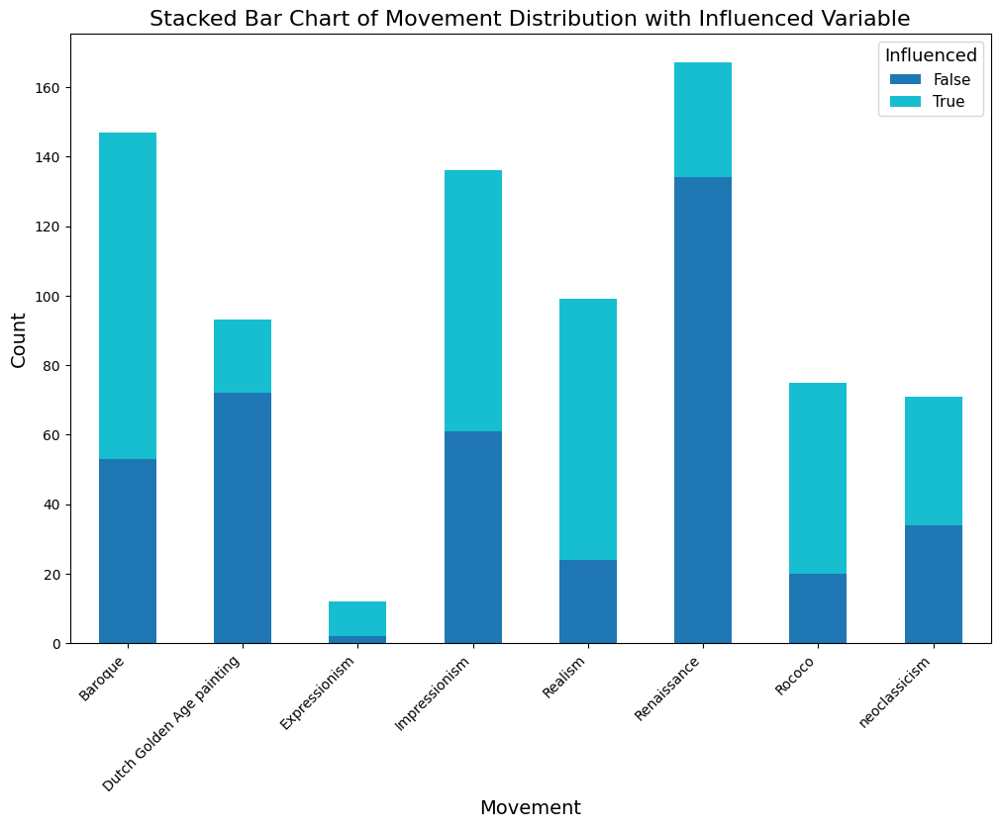

In [ ]:
# check Movement Distribution with Influenced Variable
movement_influenced_distribution = pd.crosstab(sample['movement'], sample['influenced'])
movement_influenced_distribution.plot(kind='bar', stacked=True, figsize=(12, 8), colormap='tab10')

plt.title('Stacked Bar Chart of Movement Distribution with Influenced Variable', fontsize=16)
plt.xlabel('Movement', fontsize=14)
plt.ylabel('Count', fontsize=14)
plt.xticks(rotation=45, ha='right')
plt.legend(title='Influenced', title_fontsize='13', fontsize='11')  # 修改图例标题和字体大小
plt.show()

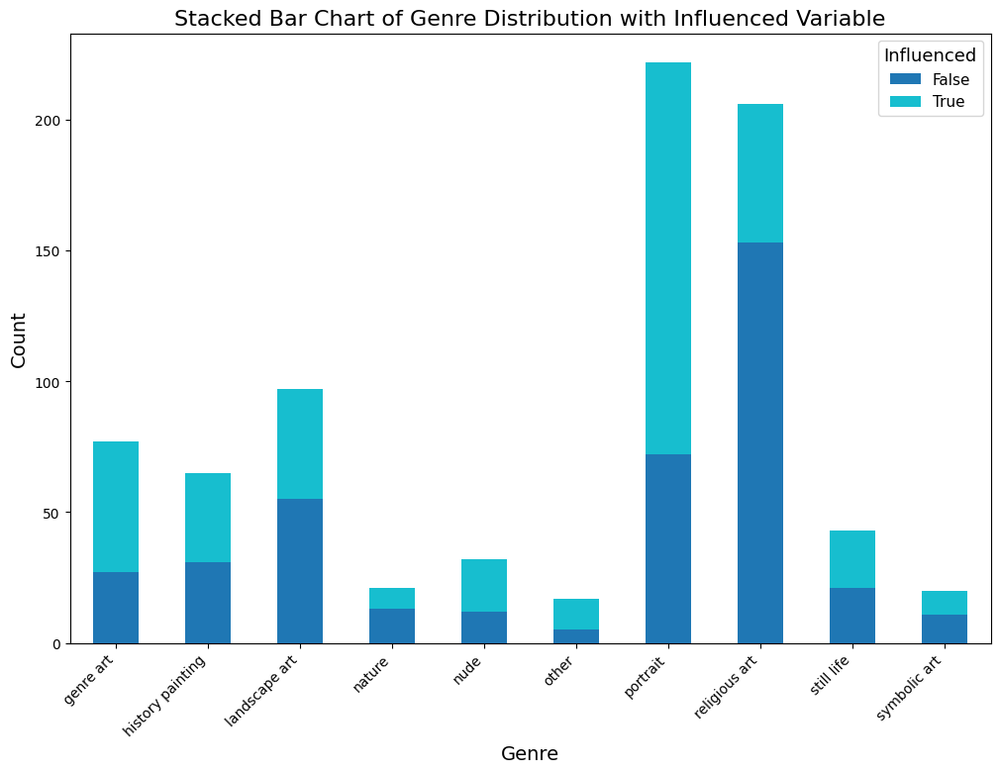

In [ ]:
# check Genre Distribution with Influenced Variable
genre_influenced_distribution = pd.crosstab(sample['genre'], sample['influenced'])
genre_influenced_distribution.plot(kind='bar', stacked=True, figsize=(12, 8), colormap='tab10')

plt.title('Stacked Bar Chart of Genre Distribution with Influenced Variable', fontsize=16)
plt.xlabel('Genre', fontsize=14)
plt.ylabel('Count', fontsize=14)
plt.xticks(rotation=45, ha='right')
plt.legend(title='Influenced', title_fontsize='13', fontsize='11')
plt.show()

In [11]:
from sklearn.model_selection import train_test_split

In [12]:
#split training set and testing set
train_df, test_df = train_test_split(sample, test_size=0.2, random_state=42)

In [13]:
# Check the amount of categories
influenced_counts_train_df = train_df['influenced'].value_counts()
print(influenced_counts_train_df)
influenced_counts_test_df = test_df['influenced'].value_counts()
print(influenced_counts_test_df)

influenced
True     320
False    320
Name: count, dtype: int64
influenced
False    80
True     80
Name: count, dtype: int64


In [ ]:
# check the number of True and False influenced in each movement in the training set
movement_influenced_counts_train = train_df.groupby(['movement', 'influenced']).size().unstack(fill_value=0)
print("Movement in train_df:")
print(movement_influenced_counts_train)

# check the number of True and False influenced in each genre in the training set
genre_influenced_counts_train = train_df.groupby(['genre', 'influenced']).size().unstack(fill_value=0)
print("\nGenre in train_df:")
print(genre_influenced_counts_train)

Movement in train_df:
influenced                   0   1
movement                          
Baroque                     43  81
Dutch Golden Age painting   54  18
Expressionism                2   9
Impressionism               48  61
Realism                     20  57
Renaissance                112  27
Rococo                      16  39
neoclassicism               25  28

Genre in train_df:
influenced          0    1
genre                     
genre art          20   41
history painting   24   28
landscape art      46   34
nature             10    7
nude               10   17
other               5    9
portrait           60  118
religious art     124   40
still life         13   18
symbolic art        8    8


In [14]:
import torch
import torch.nn as nn
import torchvision.models as models
import torchvision.transforms as transforms
from PIL import Image
import requests
from io import BytesIO
import numpy as np
from concurrent.futures import ThreadPoolExecutor
import time

In [ ]:
pip install --upgrade pillow

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.5/4.5 MB 102.5 MB/s eta 0:00:00
  Attempting uninstall: pillow
    Found existing installation: Pillow 9.4.0
    Uninstalling Pillow-9.4.0:
      Successfully uninstalled Pillow-9.4.0


In [36]:
#--------------3.Extract Features--------------

# A. Resnet
resnet = models.resnet50(pretrained=True)
# Keep only the feature extraction part
resnet = nn.Sequential(*list(resnet.children())[:-1])
resnet.eval()

# Image preprocessing
transform = transforms.Compose([
    transforms.Resize(256),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])

# Define headers with User-Agent and Referer
headers = {
    'User-Agent': 'Mozilla/5.0 (Windows NT 10.0; Win64; x64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/115.0.0.0 Safari/537.36',
    'Accept-Language': 'en-US,en;q=0.9',
    'Accept-Encoding': 'gzip, deflate, br',
    'Accept': 'text/html,application/xhtml+xml,application/xml;q=0.9,image/webp,image/apng,*/*;q=0.8',
    'Connection': 'keep-alive',
    'Referer': 'https://www.google.com/',
    'Upgrade-Insecure-Requests': '1'
}

def transform_image(img):
    # Convert image to RGB if it's not already in RGB mode
    if img.mode != 'RGB':
        img = img.convert('RGB')
    return transform(img).unsqueeze(0)

def extract_resnet_features(image_url):
    try:
        # Use headers in the request
        response = requests.get(image_url, headers=headers, timeout=30)
        response.raise_for_status()  # This will raise an exception for HTTP errors
        img = Image.open(BytesIO(response.content))

        # Transform image
        img = transform_image(img)

        # Extract features
        with torch.no_grad():
            features = resnet(img)
        return features.squeeze().numpy()

    except Exception as e:
        print(f"Failed to extract features from {image_url}: {e}")
        return None

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


In [37]:
from PIL import Image, ImageFile

# allow loading truncated images
ImageFile.LOAD_TRUNCATED_IMAGES = True

# A. Resnet
resnet = models.resnet50(pretrained=True)
# Keep only the feature extraction part
resnet = nn.Sequential(*list(resnet.children())[:-1])
resnet.eval()

# Image preprocessing
transform = transforms.Compose([
    transforms.Resize(256),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])

# Define headers with User-Agent and Referer
headers = {
    'User-Agent': 'Mozilla/5.0 (Windows NT 10.0; Win64; x64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/115.0.0.0 Safari/537.36',
    'Accept-Language': 'en-US,en;q=0.9',
    'Accept-Encoding': 'gzip, deflate, br',
    'Accept': 'text/html,application/xhtml+xml,application/xml;q=0.9,image/webp,image/apng,*/*;q=0.8',
    'Connection': 'keep-alive',
    'Referer': 'https://www.google.com/',
    'Upgrade-Insecure-Requests': '1'
}

def transform_image(img):
    # Convert image to RGB if it's not already in RGB mode
    if img.mode != 'RGB':
        img = img.convert('RGB')
    return transform(img).unsqueeze(0)

def extract_resnet_features(image_url):
    max_retries = 5
    retry_delay = 10

    for attempt in range(max_retries):
        try:
            response = requests.get(image_url, headers=headers, timeout=30)
            response.raise_for_status()  # raise an exception for HTTP errors
            img = Image.open(BytesIO(response.content))

            # Transform image
            img = transform_image(img)

            # Extract features
            with torch.no_grad():
                features = resnet(img)
            return features.squeeze().numpy()

        except requests.exceptions.HTTPError as e:
            if response.status_code == 429:
                print(f"429 Error, retrying in {retry_delay} seconds... (Attempt {attempt + 1}/{max_retries})")
                time.sleep(retry_delay)
            else:
                print(f"HTTP Error: {e}")
                return None
        except ImageFile.UnidentifiedImageError as e:
            print(f"Image file is truncated or corrupt for URL {image_url}, retrying... (Attempt {attempt + 1}/{max_retries})")
            time.sleep(retry_delay)
        except Exception as e:
            print(f"Failed to extract features from {image_url}: {e}")
            return None
    print(f"Failed to extract features from {image_url} after {max_retries} attempts.")
    return None


In [38]:
def extract_features_concurrently(image_urls, feature_extraction_fn, max_workers=8):
    with ThreadPoolExecutor(max_workers=max_workers) as executor:
        features = list(executor.map(feature_extraction_fn, image_urls))
    return features

In [39]:
# Extracting features
train_df['resnet_features'] = extract_features_concurrently(train_df['image'], extract_resnet_features)

In [42]:
test_df['resnet_features'] = extract_features_concurrently(test_df['image'], extract_resnet_features)

In [19]:
# Load a pre-trained ResNet model
resnet = models.resnet50(pretrained=True)
resnet = nn.Sequential(*list(resnet.children())[:-2])  # Keep layers up to a certain point
resnet.eval()

# Define image transformation
transform_image = transforms.Compose([
    transforms.Resize(256),
    transforms.CenterCrop(224),
    transforms.Lambda(lambda img: img.convert("RGB") if img.mode != "RGB" else img),  # Convert to RGB if not already
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])

# Define Gram Matrix computation
def gram_matrix(input_tensor):
    (b, c, h, w) = input_tensor.size()  # batch size, channels, height, width
    features = input_tensor.view(b, c, h * w)
    G = torch.bmm(features, features.transpose(1, 2))
    return G.div(h * w)

# Function to extract Gram features from a single image
def extract_gram_features(image_url):
    try:
        max_retries = 5  # Max number of retries on failure
        for attempt in range(max_retries):
            try:
                response = requests.get(image_url, headers=headers, timeout=60)
                response.raise_for_status()
                break  # Exit loop if successful
            except requests.exceptions.HTTPError as e:
                if response.status_code == 429:  # Too many requests
                    print(f"429 Error, retrying in 10 seconds... (Attempt {attempt + 1}/{max_retries})")
                    time.sleep(10)  # Wait before retrying
                else:
                    raise e
            except Exception as e:
                print(f"Failed to fetch image {image_url}: {e}")
                return None

        img = Image.open(BytesIO(response.content))
        img = transform_image(img).unsqueeze(0)  # Add batch dimension

        with torch.no_grad():
            features = resnet(img)
        gram_features = gram_matrix(features)
        return gram_features.squeeze().numpy()

    except Exception as e:
        print(f"Failed to extract gram features from {image_url}: {e}")
        return None

# Example headers (you can customize these)
headers = {
    'User-Agent': 'Mozilla/5.0 (Windows NT 10.15; Intel Mac OS X 10.15) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/91.0.4472.124 Safari/537.36',
    'Referer': 'https://www.google.com/'
}

# Function to extract features for all images with delay between requests
def extract_features_concurrently(image_urls, feature_extraction_fn, max_workers=1, delay=1):
    features = []
    for i, url in enumerate(image_urls):
        feature = feature_extraction_fn(url)
        if feature is not None:
            features.append(feature)
        time.sleep(delay)  # Delay to avoid triggering rate limits
    return features

In [20]:
train_df['gram_features'] = extract_features_concurrently(train_df['image'], extract_gram_features)

In [23]:
test_df['gram_features'] = extract_features_concurrently(test_df['image'], extract_gram_features)

In [ ]:
print(train_df['influenced'].unique())
print(test_df['influenced'].unique())

[ True False]
[False  True]


In [ ]:
train_df.to_pickle('train_df.pkl')
test_df.to_pickle('test_df.pkl')

In [ ]:
train_df = pd.read_pickle('train_df.pkl')
test_df = pd.read_pickle('test_df.pkl')

In [43]:
train_df['influenced'] = train_df['influenced'].astype(int)
test_df['influenced'] = test_df['influenced'].astype(int)

In [7]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, classification_report
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import RandomizedSearchCV
import pickle
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

In [ ]:
# PCA for Resnet

In [44]:
# turn ResNet features into NumPy
X_train = np.array(train_df['resnet_features'].tolist())
X_test = np.array(test_df['resnet_features'].tolist())

# standardize
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

In [ ]:
print(X_train.shape)

(640, 2048)


In [ ]:
# PCA, Retain 90% of the variance
pca = PCA(n_components=0.90)
X_train_pca = pca.fit_transform(X_train)
X_test_pca = pca.transform(X_test)

print(f"Reduced shape for training set: {X_train_pca.shape}")
print(f"Reduced shape for testing set: {X_test_pca.shape}")

Reduced shape for training set: (640, 137)
Reduced shape for testing set: (160, 137)


In [ ]:
# check cumulative explained variance ratio
cumulative_explained_variance_ratio = np.cumsum(pca.explained_variance_ratio_)

print("Cumulative Explained Variance Ratio of Principal Components:")
print(cumulative_explained_variance_ratio)

Cumulative Explained Variance Ratio of Principal Components:
[0.08378174 0.146617   0.19334269 0.23004787 0.25984466 0.28743488
 0.31308058 0.33380768 0.35232326 0.37010577 0.38605234 0.40133387
 0.41590694 0.42944068 0.44253635 0.45517415 0.4675061  0.47867563
 0.4896724  0.50018144 0.5100369  0.5196205  0.5288894  0.53808105
 0.5466133  0.5550857  0.5632116  0.5711073  0.57856554 0.5859885
 0.59325534 0.6004022  0.60728776 0.61378086 0.6200598  0.6262291
 0.63224727 0.6382247  0.6440434  0.6496618  0.655221   0.66072124
 0.6660789  0.6712311  0.6762803  0.6811849  0.6859516  0.6906563
 0.695266   0.69980127 0.7043137  0.7087068  0.7129632  0.71712583
 0.72123504 0.7252441  0.72922856 0.73306835 0.73687047 0.74060977
 0.7442895  0.74787253 0.7513937  0.75489503 0.7582943  0.76161647
 0.76484627 0.7680366  0.7711657  0.77427363 0.77733535 0.78035325
 0.7833325  0.7862502  0.7891354  0.7919607  0.79475117 0.7974929
 0.80011904 0.8027136  0.8052838  0.8078275  0.8103068  0.8127716
 0.815

In [ ]:
# test
n_components_list = [10, 20, 30, 40, 50]

# GridSearchCV
param_grid = {
    'n_estimators': [100, 200, 300],
    'max_depth': [None, 10, 20, 30],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'bootstrap': [True, False]
}

for n_components in n_components_list:
    print(f"\nTesting PCA with n_components = {n_components}")

    pca = PCA(n_components=n_components, random_state=42)
    X_train_pca = pca.fit_transform(X_train)
    X_test_pca = pca.transform(X_test)

    print(f"Reduced shape for training set: {X_train_pca.shape}")
    print(f"Reduced shape for testing set: {X_test_pca.shape}")

    rf = RandomForestClassifier(random_state=42)
    grid_search = GridSearchCV(estimator=rf, param_grid=param_grid, cv=5, n_jobs=-1, verbose=2)

    grid_search.fit(X_train_pca, y_train)

    print(f"Best Parameters for n_components={n_components}: {grid_search.best_params_}")
    print(f"Best Cross-Validation Score for n_components={n_components}: {grid_search.best_score_}")

    best_rf_model = grid_search.best_estimator_
    y_pred = best_rf_model.predict(X_test_pca)

    print(f"Accuracy for n_components={n_components}: {accuracy_score(y_test, y_pred)}")
    print(f"Classification Report for n_components={n_components}:\n{classification_report(y_test, y_pred)}")


Testing PCA with n_components = 10
Reduced shape for training set: (640, 10)
Reduced shape for testing set: (160, 10)
Fitting 5 folds for each of 216 candidates, totalling 1080 fits
Best Parameters for n_components=10: {'bootstrap': True, 'max_depth': None, 'min_samples_leaf': 1, 'min_samples_split': 5, 'n_estimators': 300}
Best Cross-Validation Score for n_components=10: 0.640625
Accuracy for n_components=10: 0.6875
Classification Report for n_components=10:
              precision    recall  f1-score   support

           0       0.69      0.69      0.69        80
           1       0.69      0.69      0.69        80

    accuracy                           0.69       160
   macro avg       0.69      0.69      0.69       160
weighted avg       0.69      0.69      0.69       160


Testing PCA with n_components = 20
Reduced shape for training set: (640, 20)
Reduced shape for testing set: (160, 20)
Fitting 5 folds for each of 216 candidates, totalling 1080 fits
Best Parameters for n_com

In [ ]:
# test
n_components_list = [35, 45, 55, 60, 70]

param_grid = {
    'n_estimators': [100, 200, 300],
    'max_depth': [None, 10, 20, 30],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'bootstrap': [True, False]
}

for n_components in n_components_list:
    print(f"\nTesting PCA with n_components = {n_components}")

    # 1. PCA
    pca = PCA(n_components=n_components, random_state=42)
    X_train_pca = pca.fit_transform(X_train)
    X_test_pca = pca.transform(X_test)

    # 2. rf and GridSearchCV
    rf = RandomForestClassifier(random_state=42)
    grid_search = GridSearchCV(estimator=rf, param_grid=param_grid, cv=5, n_jobs=-1, verbose=2)

    grid_search.fit(X_train_pca, y_train)

    print(f"Best Parameters for n_components={n_components}: {grid_search.best_params_}")
    print(f"Best Cross-Validation Score for n_components={n_components}: {grid_search.best_score_}")

    best_rf_model = grid_search.best_estimator_
    y_pred = best_rf_model.predict(X_test_pca)

    print(f"Accuracy for n_components={n_components}: {accuracy_score(y_test, y_pred)}")
    print(f"Classification Report for n_components={n_components}:\n{classification_report(y_test, y_pred)}")


Testing PCA with n_components = 35
Fitting 5 folds for each of 216 candidates, totalling 1080 fits
Best Parameters for n_components=35: {'bootstrap': True, 'max_depth': None, 'min_samples_leaf': 2, 'min_samples_split': 5, 'n_estimators': 100}
Best Cross-Validation Score for n_components=35: 0.675
Accuracy for n_components=35: 0.725
Classification Report for n_components=35:
              precision    recall  f1-score   support

           0       0.73      0.71      0.72        80
           1       0.72      0.74      0.73        80

    accuracy                           0.73       160
   macro avg       0.73      0.73      0.72       160
weighted avg       0.73      0.72      0.72       160


Testing PCA with n_components = 45
Fitting 5 folds for each of 216 candidates, totalling 1080 fits
Best Parameters for n_components=45: {'bootstrap': True, 'max_depth': None, 'min_samples_leaf': 2, 'min_samples_split': 10, 'n_estimators': 300}
Best Cross-Validation Score for n_components=45: 0

In [ ]:
# test
n_components_list = [51, 52, 53, 54, 56, 57]

# GridSearchCV
param_grid = {
    'n_estimators': [100, 200, 300],
    'max_depth': [None, 10, 20, 30],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'bootstrap': [True, False]
}

for n_components in n_components_list:
    print(f"\nTesting PCA with n_components = {n_components}")

    pca = PCA(n_components=n_components, random_state=42)
    X_train_pca = pca.fit_transform(X_train)
    X_test_pca = pca.transform(X_test)

    rf = RandomForestClassifier(random_state=42)
    grid_search = GridSearchCV(estimator=rf, param_grid=param_grid, cv=5, n_jobs=-1, verbose=2)

    grid_search.fit(X_train_pca, y_train)

    print(f"Best Parameters for n_components={n_components}: {grid_search.best_params_}")
    print(f"Best Cross-Validation Score for n_components={n_components}: {grid_search.best_score_}")

    best_rf_model = grid_search.best_estimator_
    y_pred = best_rf_model.predict(X_test_pca)

    print(f"Accuracy for n_components={n_components}: {accuracy_score(y_test, y_pred)}")
    print(f"Classification Report for n_components={n_components}:\n{classification_report(y_test, y_pred)}")


Testing PCA with n_components = 51
Fitting 5 folds for each of 216 candidates, totalling 1080 fits
Best Parameters for n_components=51: {'bootstrap': True, 'max_depth': None, 'min_samples_leaf': 2, 'min_samples_split': 2, 'n_estimators': 300}
Best Cross-Validation Score for n_components=51: 0.6703125
Accuracy for n_components=51: 0.7375
Classification Report for n_components=51:
              precision    recall  f1-score   support

           0       0.74      0.74      0.74        80
           1       0.74      0.74      0.74        80

    accuracy                           0.74       160
   macro avg       0.74      0.74      0.74       160
weighted avg       0.74      0.74      0.74       160


Testing PCA with n_components = 52
Fitting 5 folds for each of 216 candidates, totalling 1080 fits
Best Parameters for n_components=52: {'bootstrap': True, 'max_depth': None, 'min_samples_leaf': 1, 'min_samples_split': 10, 'n_estimators': 100}
Best Cross-Validation Score for n_components=

In [45]:
# PCA
pca = PCA(n_components=52,random_state=42)
X_train_pca = pca.fit_transform(X_train)
X_test_pca = pca.transform(X_test)

print(f"Reduced shape for training set: {X_train_pca.shape}")
print(f"Reduced shape for testing set: {X_test_pca.shape}")

Reduced shape for training set: (640, 52)
Reduced shape for testing set: (160, 52)


In [46]:
# Resnet features and labels
y_train = train_df['influenced'].values
y_test = test_df['influenced'].values

In [ ]:
# Random Forest for Resnet

In [47]:
# grid search
param_grid = {
    'n_estimators': [100, 200, 300],
    'max_depth': [None, 10, 20, 30],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'bootstrap': [True, False]
}

# rf
rf = RandomForestClassifier(random_state=42)

# GridSearchCV for best parameter combination
grid_search = GridSearchCV(estimator=rf, param_grid=param_grid, cv=5, n_jobs=-1, verbose=2)
grid_search.fit(X_train_pca, y_train)

print(f"Best Parameters: {grid_search.best_params_}")
print(f"Best Cross-Validation Score: {grid_search.best_score_}")

# predict
best_rf_model = grid_search.best_estimator_
y_pred = best_rf_model.predict(X_test_pca)

print("Accuracy:", accuracy_score(y_test, y_pred))
print("Classification Report:\n", classification_report(y_test, y_pred))

Fitting 5 folds for each of 216 candidates, totalling 1080 fits
Best Parameters: {'bootstrap': True, 'max_depth': None, 'min_samples_leaf': 1, 'min_samples_split': 10, 'n_estimators': 100}
Best Cross-Validation Score: 0.678125
Accuracy: 0.74375
Classification Report:
               precision    recall  f1-score   support

           0       0.72      0.80      0.76        80
           1       0.77      0.69      0.73        80

    accuracy                           0.74       160
   macro avg       0.75      0.74      0.74       160
weighted avg       0.75      0.74      0.74       160



In [48]:
y_prob = best_rf_model.predict_proba(X_test_pca)[:, 1]

In [49]:
y_prob = best_rf_model.predict_proba(X_test_pca)[:, 1]
df_pr = pd.DataFrame(y_prob, columns=['y_prob'])

# 保存到 CSV 文件
df_pr.to_csv('y_prob_resnet.csv', index=False)

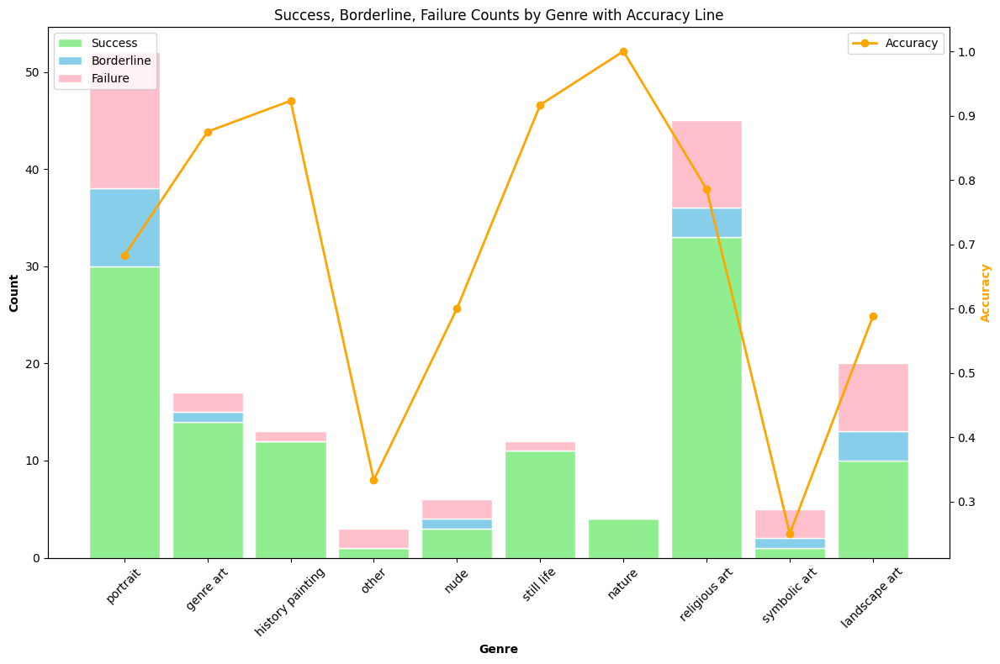

In [ ]:
# visualization of Success, Borderline, Failure Counts by Genre with Accuracy Line
genre_test = test_df['genre'].values
y_prob = best_rf_model.predict_proba(X_test_pca)[:, 1]

df_results = pd.DataFrame({
    'actual_label': y_test,
    'predicted_label': y_pred,
    'genre': genre_test
})

success = df_results[df_results['actual_label'] == df_results['predicted_label']]
failure = df_results[df_results['actual_label'] != df_results['predicted_label']]
borderline = df_results[(df_results['actual_label'] != df_results['predicted_label']) &
                        (y_prob > 0.45) & (y_prob < 0.55)]

success_genre_count = success['genre'].value_counts()
borderline_genre_count = borderline['genre'].value_counts()
failure_genre_count = failure['genre'].value_counts()

genre_labels = list(set(success_genre_count.index) | set(borderline_genre_count.index) | set(failure_genre_count.index))
success_genre_count = success_genre_count.reindex(genre_labels, fill_value=0)
borderline_genre_count = borderline_genre_count.reindex(genre_labels, fill_value=0)
failure_genre_count = failure_genre_count.reindex(genre_labels, fill_value=0)

total_genre_count = df_results['genre'].value_counts().reindex(genre_labels, fill_value=0)
accuracy_genre = success_genre_count / total_genre_count

barWidth = 0.85
r = np.arange(len(genre_labels))

fig, ax1 = plt.subplots(figsize=(12, 8))

ax1.bar(r, success_genre_count, color='lightgreen', edgecolor='white', width=barWidth, label='Success')
ax1.bar(r, borderline_genre_count, bottom=success_genre_count, color='skyblue', edgecolor='white', width=barWidth, label='Borderline')
ax1.bar(r, failure_genre_count, bottom=success_genre_count+borderline_genre_count, color='pink', edgecolor='white', width=barWidth, label='Failure')

ax1.set_xlabel('Genre', fontweight='bold')
ax1.set_ylabel('Count', fontweight='bold')
ax1.set_xticks(r)
ax1.set_xticklabels(genre_labels, rotation=45)
ax1.legend(loc='upper left')

ax2 = ax1.twinx()
ax2.plot(r, accuracy_genre, color='orange', marker='o', linestyle='-', linewidth=2, label='Accuracy')
ax2.set_ylabel('Accuracy', fontweight='bold', color='orange')
ax2.legend(loc='upper right')

plt.title('Success, Borderline, Failure Counts by Genre with Accuracy Line')
plt.tight_layout()
plt.show()

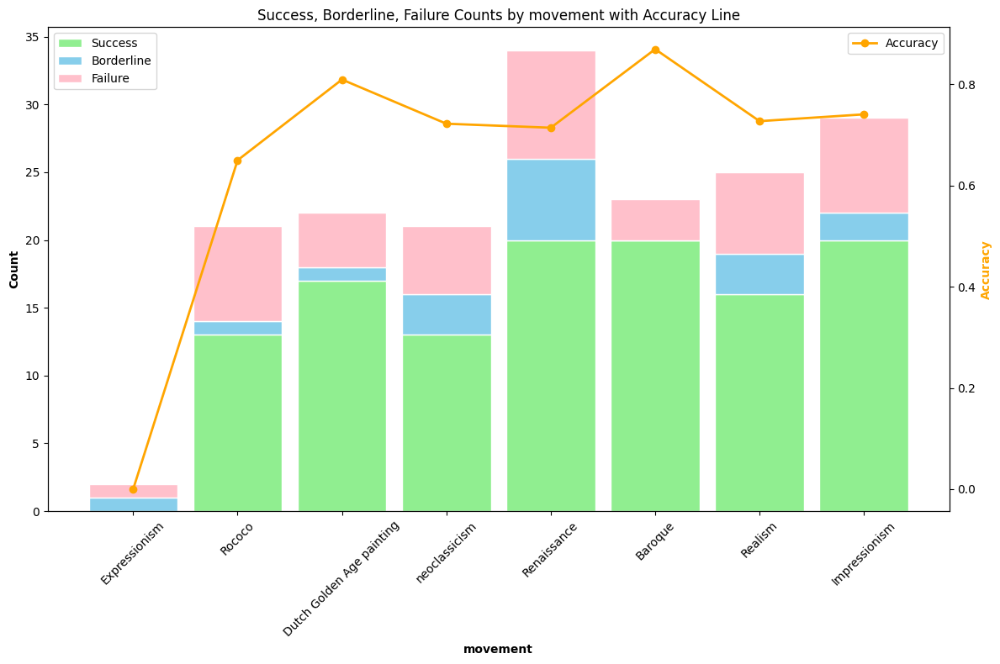

In [ ]:
# visualization of Success, Borderline, Failure Counts by movement with Accuracy Line
movement_test = test_df['movement'].values

df_results = pd.DataFrame({
    'actual_label': y_test,
    'predicted_label': y_pred,
    'movement': movement_test
})

success = df_results[df_results['actual_label'] == df_results['predicted_label']]
failure = df_results[df_results['actual_label'] != df_results['predicted_label']]
borderline = df_results[(df_results['actual_label'] != df_results['predicted_label']) &
                        (y_prob > 0.45) & (y_prob < 0.55)]

success_movement_count = success['movement'].value_counts()
borderline_movement_count = borderline['movement'].value_counts()
failure_movement_count = failure['movement'].value_counts()

movement_labels = list(set(success_movement_count.index) | set(borderline_movement_count.index) | set(failure_movement_count.index))
success_movement_count = success_movement_count.reindex(movement_labels, fill_value=0)
borderline_movement_count = borderline_movement_count.reindex(movement_labels, fill_value=0)
failure_movement_count = failure_movement_count.reindex(movement_labels, fill_value=0)

total_movement_count = df_results['movement'].value_counts().reindex(movement_labels, fill_value=0)
accuracy_movement = success_movement_count / total_movement_count

barWidth = 0.85
r = np.arange(len(movement_labels))

fig, ax1 = plt.subplots(figsize=(12, 8))

ax1.bar(r, success_movement_count, color='lightgreen', edgecolor='white', width=barWidth, label='Success')
ax1.bar(r, borderline_movement_count, bottom=success_movement_count, color='skyblue', edgecolor='white', width=barWidth, label='Borderline')
ax1.bar(r, failure_movement_count, bottom=success_movement_count+borderline_movement_count, color='pink', edgecolor='white', width=barWidth, label='Failure')

ax1.set_xlabel('movement', fontweight='bold')
ax1.set_ylabel('Count', fontweight='bold')
ax1.set_xticks(r)
ax1.set_xticklabels(movement_labels, rotation=45)
ax1.legend(loc='upper left')

ax2 = ax1.twinx()
ax2.plot(r, accuracy_movement, color='orange', marker='o', linestyle='-', linewidth=2, label='Accuracy')
ax2.set_ylabel('Accuracy', fontweight='bold', color='orange')
ax2.legend(loc='upper right')

plt.title('Success, Borderline, Failure Counts by movement with Accuracy Line')
plt.tight_layout()
plt.show()

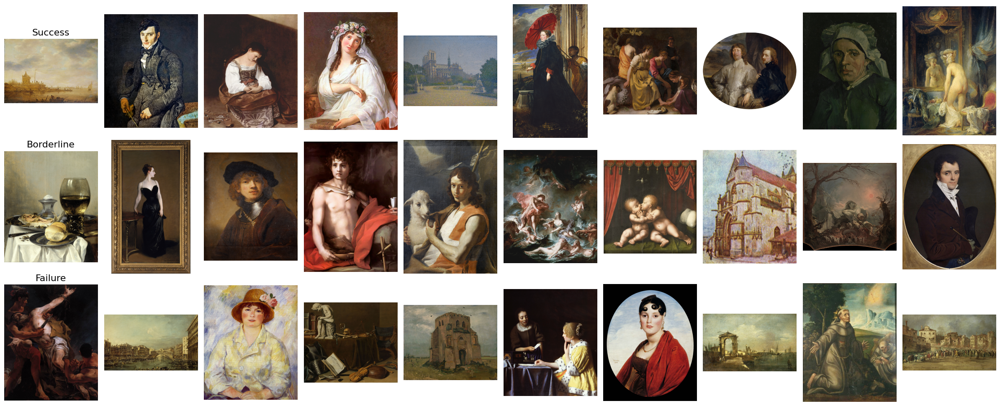

In [ ]:
from matplotlib.offsetbox import OffsetImage, AnnotationBbox

# define the range of borderline
borderline_min = 0.45
borderline_max = 0.55

# define success_indices, failure_indices & borderline_indices
success_indices = np.where(y_test == y_pred)[0]
failure_indices = np.where(y_test != y_pred)[0]
borderline_indices = np.where((y_prob > borderline_min) & (y_prob < borderline_max))[0]

# Function to download and open the image with updated User-Agent
def download_image(image_url):
    headers = {
        'User-Agent': 'Mozilla/5.0 (Windows NT 10.0; Win64; x64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/115.0.0.0 Safari/537.36',
    }
    try:
        response = requests.get(image_url, headers=headers)
        response.raise_for_status()
        img = Image.open(BytesIO(response.content))
        return img
    except (requests.exceptions.RequestException, UnidentifiedImageError) as e:
        print(f"Could not open image from {image_url}: {e}")
        return None

# Function to add an image to the subplot
def add_image_to_subplot(ax, image_url):
    img = download_image(image_url)
    if img is not None:
        ax.imshow(img)
        ax.axis('off')

# Remove borderline images from success and failure sets
success_set = set(success_indices) - set(borderline_indices)
failure_set = set(failure_indices) - set(borderline_indices)

# Convert back to list and limit to the first 10 images for each category
success_images = list(success_set)[:10]
failure_images = list(failure_set)[:10]
borderline_images = borderline_indices[:10]

# Create a figure for the montage (3 rows, 10 columns)
fig, axs = plt.subplots(3, 10, figsize=(24, 10))

# Plot Success Images (First Row)
for i, idx in enumerate(success_images):
    add_image_to_subplot(axs[0, i % 10], test_df.iloc[idx]['image'])

# Plot Borderline Images (Second Row)
for i, idx in enumerate(borderline_images):
    add_image_to_subplot(axs[1, i % 10], test_df.iloc[idx]['image'])

# Plot Failure Images (Third Row)
for i, idx in enumerate(failure_images):
    add_image_to_subplot(axs[2, i % 10], test_df.iloc[idx]['image'])

# Set titles for rows
axs[0, 0].set_title('Success', fontsize=16)
axs[1, 0].set_title('Borderline', fontsize=16)
axs[2, 0].set_title('Failure', fontsize=16)

# Remove axis for all subplots
for ax in axs.flat:
    ax.axis('off')

plt.tight_layout()
plt.show()

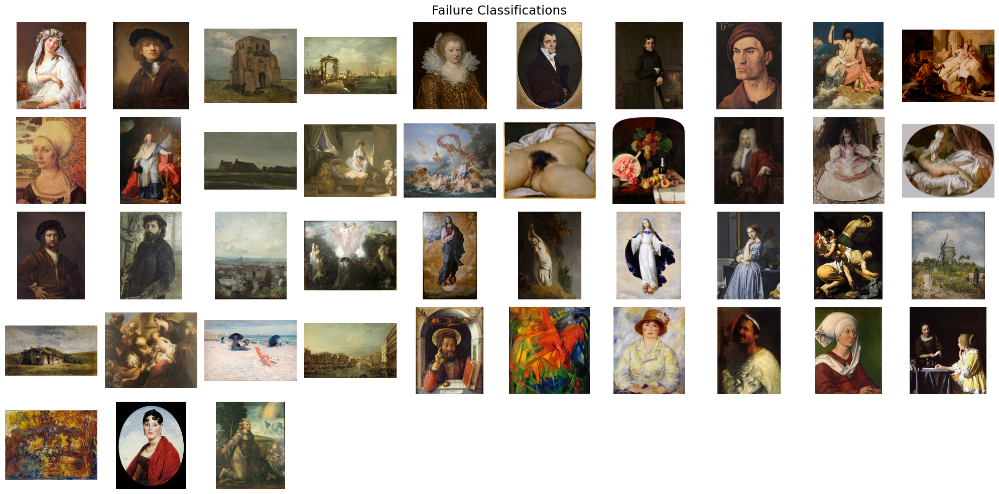

In [ ]:
import matplotlib.pyplot as plt
from matplotlib.offsetbox import OffsetImage, AnnotationBbox
from PIL import Image, UnidentifiedImageError
import requests
from io import BytesIO

# Function to download and open the image with updated User-Agent
def download_image(image_url):
    headers = {
        'User-Agent': 'Mozilla/5.0 (Windows NT 10.0; Win64; x64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/115.0.0.0 Safari/537.36',
    }
    try:
        response = requests.get(image_url, headers=headers)
        response.raise_for_status()
        img = Image.open(BytesIO(response.content))
        return img
    except (requests.exceptions.RequestException, UnidentifiedImageError) as e:
        print(f"Could not open image from {image_url}: {e}")
        return None

# Function to add an image to the subplot
def add_image_to_subplot(ax, image_url):
    img = download_image(image_url)
    if img is not None:
        ax.imshow(img)
        ax.axis('off')

# Define the number of images to display (50 failure images)
failure_images = failure_indices  # Only showing the first 50 failure images

# Create a figure for the montage, with 5 rows and 10 columns
fig, axs = plt.subplots(5, 10, figsize=(20, 10))

# Plot Failure Images (All Rows)
for i, idx in enumerate(failure_images):
    row = i // 10  # Calculate the row index
    col = i % 10   # Calculate the column index
    add_image_to_subplot(axs[row, col], test_df.iloc[idx]['image'])

# Set title for the entire figure
fig.suptitle('Failure Classifications', fontsize=18)

# Remove axis for all subplots
for ax in axs.flat:
    ax.axis('off')

plt.tight_layout()
plt.show()


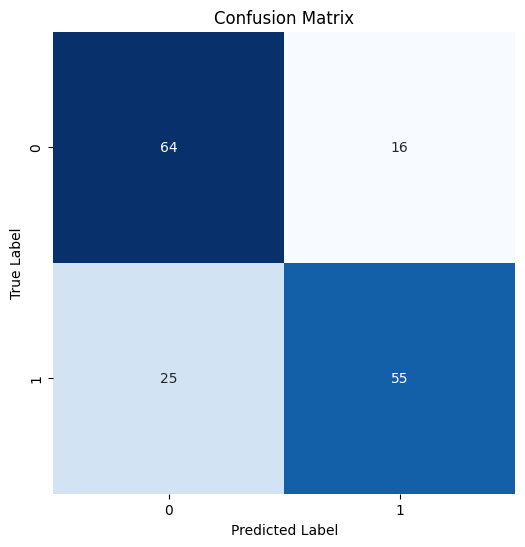

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix

# confusion matrix
cm = confusion_matrix(y_test, y_pred)

# Visualize the confusion matrix using a heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", cbar=False, square=True)
plt.title('Confusion Matrix')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()

In [ ]:
# save failed images
failure_data = test_df.iloc[failure_indices].copy()
failure_data['actual_label'] = y_test[failure_indices]
failure_data['predicted_label'] = y_pred[failure_indices]
failure_data_to_save = failure_data[['image', 'actual_label', 'predicted_label','movement','genre']]

failure_data_to_save.to_csv('resnet_failures.csv', index=False)

print("resnet Failed classification data saved to classification_failures.csv")

resnet Failed classification data saved to classification_failures.csv


In [ ]:
# save succeed images
success_data = test_df.iloc[success_indices].copy()
success_data['actual_label'] = y_test[success_indices]
success_data['predicted_label'] = y_pred[success_indices]
success_data_to_save = success_data[['image', 'actual_label', 'predicted_label','movement','genre']]

success_data_to_save.to_csv('resnet_successs.csv', index=False)

print("resnet succeed classification data saved to classification_successs.csv")

resnet succeed classification data saved to classification_successs.csv


In [ ]:
# save borderline images
borderline_data = test_df.iloc[borderline_indices].copy()
borderline_data['actual_label'] = y_test[borderline_indices]
borderline_data['predicted_label'] = y_pred[borderline_indices]
borderline_data_to_save = borderline_data[['image', 'actual_label', 'predicted_label','movement','genre']]

borderline_data_to_save.to_csv('resnet_borderlines.csv', index=False)

print("resnet borderline classification data saved to classification_borderlines.csv")

resnet borderline classification data saved to classification_borderlines.csv


In [24]:
# Gram Matrix
X_train1 = np.array(train_df['gram_features'].tolist())
y_train1 = train_df['influenced'].values

X_test1 = np.array(test_df['gram_features'].tolist())
y_test1 = test_df['influenced'].values

In [25]:
# flattern to 2D
X_train1 = X_train1.reshape(X_train1.shape[0], -1)
X_test1 = X_test1.reshape(X_test1.shape[0], -1)

In [ ]:
print(X_train1.shape)

(640, 4194304)


In [ ]:
import pickle
# 将X_train1和X_test1保存为.pkl文件
with open('X_train1.pkl', 'wb') as f:
    pickle.dump(X_train1, f)

with open('X_test1.pkl', 'wb') as f:
    pickle.dump(X_test1, f)

# 也可以保存y_train1和y_test1
with open('y_train1.pkl', 'wb') as f:
    pickle.dump(y_train1, f)

with open('y_test1.pkl', 'wb') as f:
    pickle.dump(y_test1, f)

In [ ]:
import pickle
# read
with open('X_train1.pkl', 'rb') as f:
    X_train1 = pickle.load(f)

with open('X_test1.pkl', 'rb') as f:
    X_test1 = pickle.load(f)

with open('y_train1.pkl', 'rb') as f:
    y_train1 = pickle.load(f)

with open('y_test1.pkl', 'rb') as f:
    y_test1 = pickle.load(f)

In [ ]:
# 将X_train1和X_test1保存为.pkl文件
with open('X_train1_scaled.pkl', 'wb') as f:
    pickle.dump(X_train1_scaled, f)

with open('X_test1_scaled.pkl', 'wb') as f:
    pickle.dump(X_test1_scaled, f)

In [ ]:
import pickle
# read
with open('X_train1_scaled.pkl', 'rb') as f:
    X_train1_scaled = pickle.load(f)

with open('X_test1_scaled.pkl', 'rb') as f:
    X_test1_scaled = pickle.load(f)

with open('y_train1.pkl', 'rb') as f:
    y_train1 = pickle.load(f)

with open('y_test1.pkl', 'rb') as f:
    y_test1 = pickle.load(f)

In [ ]:
# PCA for gram matrices

In [ ]:
import gc
from sklearn.decomposition import IncrementalPCA
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import cross_val_score
from sklearn.ensemble import RandomForestClassifier

# find the best number of PCA retained for the highest classification accuracy

n_batches = 10
best_score = 0
best_n_components = 0

# define range
components_range = [10, 20, 30, 40]


for n_components in components_range:
    scaler = StandardScaler()
    for X_batch in np.array_split(X_train1, n_batches):
        scaler.partial_fit(X_batch)
    ipca = IncrementalPCA(n_components=n_components)

    for X_batch in np.array_split(X_train1, n_batches):
        X_batch_normalized = scaler.transform(X_batch)
        ipca.partial_fit(X_batch_normalized)
        del X_batch, X_batch_normalized
        gc.collect()

    X_train1_pca = []
    for X_batch in np.array_split(X_train1, n_batches):
        X_batch_normalized = scaler.transform(X_batch)
        X_train1_pca.append(ipca.transform(X_batch_normalized))
        del X_batch, X_batch_normalized
        gc.collect()

    X_train1_pca = np.vstack(X_train1_pca)

    # 5. cross validation
    rf = RandomForestClassifier()
    scores = cross_val_score(rf, X_train1_pca, y_train1, cv=5)
    mean_score = np.mean(scores)

    print(f"n_components = {n_components}, Cross-Validation Score: {mean_score}")

    if mean_score > best_score:
        best_score = mean_score
        best_n_components = n_components

print(f"Best n_components: {best_n_components}, Best CV Score: {best_score}")

n_components = 10, Cross-Validation Score: 0.6359375
n_components = 20, Cross-Validation Score: 0.6484375
n_components = 30, Cross-Validation Score: 0.6890625
n_components = 40, Cross-Validation Score: 0.6703125
Best n_components: 30, Best CV Score: 0.6890625


In [26]:
import gc
from sklearn.decomposition import IncrementalPCA
from sklearn.preprocessing import StandardScaler

# Set the number of batches and the number of features after PCA dimensionality reduction
n_batches = 10
n_components = 32

# 1. Create an instance of StandardScaler
scaler = StandardScaler()

# 2. Compute the mean and standard deviation of the training data (through partial fitting on batch data)
for X_batch in np.array_split(X_train1, n_batches):
    scaler.partial_fit(X_batch)  # partial_fit is used for incremental computation of mean and standard deviation

# 3. Initialize IncrementalPCA and perform partial fitting on the training data
ipca = IncrementalPCA(n_components=n_components)

# First, perform partial fitting on the training data (incrementally)
for X_batch in np.array_split(X_train1, n_batches):
    X_batch_normalized = scaler.transform(X_batch)  # Normalize the current batch of data
    ipca.partial_fit(X_batch_normalized)  # Perform partial fitting on the current batch
    del X_batch, X_batch_normalized  # Delete the current batch to free up memory
    gc.collect()  # Manual garbage collection

# 4. Transform the training data into reduced features
X_train1_pca = []
for X_batch in np.array_split(X_train1, n_batches):
    X_batch_normalized = scaler.transform(X_batch)
    X_train1_pca.append(ipca.transform(X_batch_normalized))
    del X_batch, X_batch_normalized
    gc.collect()

X_train1_pca = np.vstack(X_train1_pca)  # Combine the results from all batches

# 5. Apply the same process to the test data
X_test1_pca = []
for X_batch in np.array_split(X_test1, n_batches):
    X_batch_normalized = scaler.transform(X_batch)
    X_test1_pca.append(ipca.transform(X_batch_normalized))
    del X_batch, X_batch_normalized
    gc.collect()

X_test1_pca = np.vstack(X_test1_pca)  # Combine the results from all batches

print(f"Reduced shape: {X_train1_pca.shape}")

Reduced shape: (640, 32)


In [ ]:
import gc
from sklearn.decomposition import IncrementalPCA
from sklearn.preprocessing import StandardScaler

# Set the number of batches and the number of features after PCA dimensionality reduction
n_batches = 10
n_components = 33

# 1. Create an instance of StandardScaler
scaler = StandardScaler()

# 2. Compute the mean and standard deviation of the training data (through partial fitting on batch data)
for X_batch in np.array_split(X_train1, n_batches):
    scaler.partial_fit(X_batch)  # partial_fit is used for incremental computation of mean and standard deviation

# 3. Initialize IncrementalPCA and perform partial fitting on the training data
ipca = IncrementalPCA(n_components=n_components)

# First, perform partial fitting on the training data (incrementally)
for X_batch in np.array_split(X_train1, n_batches):
    X_batch_normalized = scaler.transform(X_batch)  # Normalize the current batch of data
    ipca.partial_fit(X_batch_normalized)  # Perform partial fitting on the current batch
    del X_batch, X_batch_normalized  # Delete the current batch to free up memory
    gc.collect()  # Manual garbage collection

# 4. Transform the training data into reduced features
X_train1_pca = []
for X_batch in np.array_split(X_train1, n_batches):
    X_batch_normalized = scaler.transform(X_batch)
    X_train1_pca.append(ipca.transform(X_batch_normalized))
    del X_batch, X_batch_normalized
    gc.collect()

X_train1_pca = np.vstack(X_train1_pca)  # Combine the results from all batches

# 5. Apply the same process to the test data
X_test1_pca = []
for X_batch in np.array_split(X_test1, n_batches):
    X_batch_normalized = scaler.transform(X_batch)
    X_test1_pca.append(ipca.transform(X_batch_normalized))
    del X_batch, X_batch_normalized
    gc.collect()

X_test1_pca = np.vstack(X_test1_pca)  # Combine the results from all batches

print(f"Reduced shape: {X_train1_pca.shape}")

Reduced shape: (640, 33)


In [ ]:
import gc
from sklearn.decomposition import IncrementalPCA
from sklearn.preprocessing import StandardScaler

# Set the number of batches and the number of features after PCA dimensionality reduction
n_batches = 10
n_components = 31

# 1. Create an instance of StandardScaler
scaler = StandardScaler()

# 2. Compute the mean and standard deviation of the training data (through partial fitting on batch data)
for X_batch in np.array_split(X_train1, n_batches):
    scaler.partial_fit(X_batch)  # partial_fit is used for incremental computation of mean and standard deviation

# 3. Initialize IncrementalPCA and perform partial fitting on the training data
ipca = IncrementalPCA(n_components=n_components)

# First, perform partial fitting on the training data (incrementally)
for X_batch in np.array_split(X_train1, n_batches):
    X_batch_normalized = scaler.transform(X_batch)  # Normalize the current batch of data
    ipca.partial_fit(X_batch_normalized)  # Perform partial fitting on the current batch
    del X_batch, X_batch_normalized  # Delete the current batch to free up memory
    gc.collect()  # Manual garbage collection

# 4. Transform the training data into reduced features
X_train1_pca = []
for X_batch in np.array_split(X_train1, n_batches):
    X_batch_normalized = scaler.transform(X_batch)
    X_train1_pca.append(ipca.transform(X_batch_normalized))
    del X_batch, X_batch_normalized
    gc.collect()

X_train1_pca = np.vstack(X_train1_pca)  # Combine the results from all batches

# 5. Apply the same process to the test data
X_test1_pca = []
for X_batch in np.array_split(X_test1, n_batches):
    X_batch_normalized = scaler.transform(X_batch)
    X_test1_pca.append(ipca.transform(X_batch_normalized))
    del X_batch, X_batch_normalized
    gc.collect()

X_test1_pca = np.vstack(X_test1_pca)  # Combine the results from all batches

print(f"Reduced shape: {X_train1_pca.shape}")

Reduced shape: (640, 31)


In [ ]:
# calculate cumulative explained variance
explained_variance_ratio = ipca.explained_variance_ratio_
cumulative_explained_variance = np.cumsum(explained_variance_ratio)

print("Cumulative explained variance:")
print(cumulative_explained_variance)

Cumulative explained variance:
[0.04433557 0.07448377 0.10005776 0.1235363  0.14283215 0.15849886
 0.17377155 0.18681278 0.19873593 0.21032328 0.22110482 0.2313234
 0.24124715 0.25103441 0.26010087 0.26895613 0.27742875 0.28583983
 0.29390139 0.30156086 0.30911778 0.31664087 0.32344336 0.33011109
 0.33650805 0.3425544  0.34841239 0.35404445 0.35947766 0.36478251
 0.36976718 0.37467003 0.37942612]


In [ ]:
import pickle
# read
with open('X_train1_pca.pkl', 'rb') as f:
    X_train1_pca = pickle.load(f)

with open('X_test1_pca.pkl', 'rb') as f:
    X_test1_pca = pickle.load(f)

with open('y_train1.pkl', 'rb') as f:
    y_train1 = pickle.load(f)

with open('y_test1.pkl', 'rb') as f:
    y_test1 = pickle.load(f)

In [ ]:
# random forst for gram matrices

In [ ]:
# define grid 32
param_grid = {
    'n_estimators': [100, 200, 300],
    'max_depth': [None, 10, 20, 30],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'bootstrap': [True, False]
}

# rf
rf = RandomForestClassifier(random_state=42)

# GridSearchCV for best parameters
grid_search = GridSearchCV(estimator=rf, param_grid=param_grid, cv=5, n_jobs=-1, verbose=2)
grid_search.fit(X_train1_pca, y_train1)

print(f"Best Parameters: {grid_search.best_params_}")
print(f"Best Cross-Validation Score: {grid_search.best_score_}")

# predict
best_rf_model = grid_search.best_estimator_
y_pred1 = best_rf_model.predict(X_test1_pca)

print("Accuracy:", accuracy_score(y_test1, y_pred1))
print("Classification Report:\n", classification_report(y_test1, y_pred1))

Fitting 5 folds for each of 216 candidates, totalling 1080 fits
Best Parameters: {'bootstrap': True, 'max_depth': 10, 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 300}
Best Cross-Validation Score: 0.684375
Accuracy: 0.73125
Classification Report:
               precision    recall  f1-score   support

           0       0.73      0.74      0.73        80
           1       0.73      0.72      0.73        80

    accuracy                           0.73       160
   macro avg       0.73      0.73      0.73       160
weighted avg       0.73      0.73      0.73       160



In [ ]:
# define grid 33
param_grid = {
    'n_estimators': [100, 200, 300],
    'max_depth': [None, 10, 20, 30],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'bootstrap': [True, False]
}

# rf
rf = RandomForestClassifier(random_state=42)

# GridSearchCV for best parameters
grid_search = GridSearchCV(estimator=rf, param_grid=param_grid, cv=5, n_jobs=-1, verbose=2)
grid_search.fit(X_train1_pca, y_train1)

print(f"Best Parameters: {grid_search.best_params_}")
print(f"Best Cross-Validation Score: {grid_search.best_score_}")

# predict
best_rf_model = grid_search.best_estimator_
y_pred1 = best_rf_model.predict(X_test1_pca)

print("Accuracy:", accuracy_score(y_test1, y_pred1))
print("Classification Report:\n", classification_report(y_test1, y_pred1))

Fitting 5 folds for each of 216 candidates, totalling 1080 fits
Best Parameters: {'bootstrap': False, 'max_depth': None, 'min_samples_leaf': 1, 'min_samples_split': 10, 'n_estimators': 300}
Best Cross-Validation Score: 0.684375
Accuracy: 0.725
Classification Report:
               precision    recall  f1-score   support

           0       0.72      0.72      0.73        80
           1       0.72      0.72      0.73        80

    accuracy                           0.73       160
   macro avg       0.72      0.72      0.73       160
weighted avg       0.72      0.72      0.73       160



In [ ]:
# define grid 31
param_grid = {
    'n_estimators': [100, 200, 300],
    'max_depth': [None, 10, 20, 30],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'bootstrap': [True, False]
}

# rf
rf = RandomForestClassifier(random_state=42)

# GridSearchCV for best parameters
grid_search = GridSearchCV(estimator=rf, param_grid=param_grid, cv=5, n_jobs=-1, verbose=2)
grid_search.fit(X_train1_pca, y_train1)

print(f"Best Parameters: {grid_search.best_params_}")
print(f"Best Cross-Validation Score: {grid_search.best_score_}")

# predict
best_rf_model = grid_search.best_estimator_
y_pred1 = best_rf_model.predict(X_test1_pca)

print("Accuracy:", accuracy_score(y_test1, y_pred1))
print("Classification Report:\n", classification_report(y_test1, y_pred1))

Fitting 5 folds for each of 216 candidates, totalling 1080 fits
Best Parameters: {'bootstrap': True, 'max_depth': 10, 'min_samples_leaf': 1, 'min_samples_split': 5, 'n_estimators': 300}
Best Cross-Validation Score: 0.69375
Accuracy: 0.71875
Classification Report:
               precision    recall  f1-score   support

           0       0.73      0.70      0.71        80
           1       0.71      0.74      0.72        80

    accuracy                           0.72       160
   macro avg       0.72      0.72      0.72       160
weighted avg       0.72      0.72      0.72       160



In [ ]:
# define grid 39
param_grid = {
    'n_estimators': [100, 200, 300],
    'max_depth': [None, 10, 20, 30],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'bootstrap': [True, False]
}

# rf
rf = RandomForestClassifier(random_state=42)

# GridSearchCV for best parameters
grid_search = GridSearchCV(estimator=rf, param_grid=param_grid, cv=5, n_jobs=-1, verbose=2)
grid_search.fit(X_train1_pca, y_train1)

print(f"Best Parameters: {grid_search.best_params_}")
print(f"Best Cross-Validation Score: {grid_search.best_score_}")

# predict
best_rf_model = grid_search.best_estimator_
y_pred1 = best_rf_model.predict(X_test1_pca)

print("Accuracy:", accuracy_score(y_test1, y_pred1))
print("Classification Report:\n", classification_report(y_test1, y_pred1))

Fitting 5 folds for each of 216 candidates, totalling 1080 fits
Best Parameters: {'bootstrap': False, 'max_depth': None, 'min_samples_leaf': 2, 'min_samples_split': 5, 'n_estimators': 300}
Best Cross-Validation Score: 0.6875
Accuracy: 0.68125
Classification Report:
               precision    recall  f1-score   support

           0       0.69      0.66      0.68        80
           1       0.67      0.70      0.69        80

    accuracy                           0.68       160
   macro avg       0.68      0.68      0.68       160
weighted avg       0.68      0.68      0.68       160



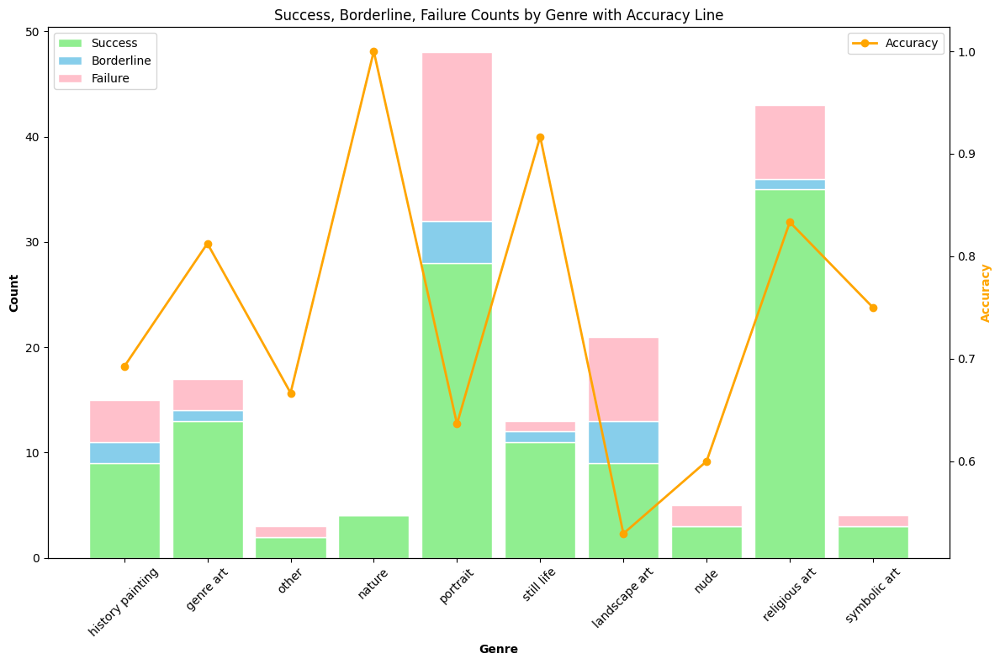

In [28]:
# visualization of Success, Borderline, Failure Counts by Genre with Accuracy Line
genre_test1 = test_df['genre'].values
y_prob1 = best_rf_model.predict_proba(X_test1_pca)[:, 1]

df_results = pd.DataFrame({
    'actual_label': y_test1,
    'predicted_label': y_pred1,
    'genre': genre_test1
})

# define success, failure, borderline

success = df_results[df_results['actual_label'] == df_results['predicted_label']]
failure = df_results[df_results['actual_label'] != df_results['predicted_label']]

borderline = df_results[(df_results['actual_label'] != df_results['predicted_label']) &
                        (y_prob1 > 0.45) & (y_prob1 < 0.55)]

success_genre_count = success['genre'].value_counts()
borderline_genre_count = borderline['genre'].value_counts()
failure_genre_count = failure['genre'].value_counts()

# data prepering
genre_labels = list(set(success_genre_count.index) | set(borderline_genre_count.index) | set(failure_genre_count.index))
success_genre_count = success_genre_count.reindex(genre_labels, fill_value=0)
borderline_genre_count = borderline_genre_count.reindex(genre_labels, fill_value=0)
failure_genre_count = failure_genre_count.reindex(genre_labels, fill_value=0)

# accuracy
total_genre_count = df_results['genre'].value_counts().reindex(genre_labels, fill_value=0)
accuracy_genre = success_genre_count / total_genre_count

# bar plot
barWidth = 0.85
r = np.arange(len(genre_labels))

fig, ax1 = plt.subplots(figsize=(12, 8))

ax1.bar(r, success_genre_count, color='lightgreen', edgecolor='white', width=barWidth, label='Success')
ax1.bar(r, borderline_genre_count, bottom=success_genre_count, color='skyblue', edgecolor='white', width=barWidth, label='Borderline')
ax1.bar(r, failure_genre_count, bottom=success_genre_count+borderline_genre_count, color='pink', edgecolor='white', width=barWidth, label='Failure')

ax1.set_xlabel('Genre', fontweight='bold')
ax1.set_ylabel('Count', fontweight='bold')
ax1.set_xticks(r)
ax1.set_xticklabels(genre_labels, rotation=45)
ax1.legend(loc='upper left')

ax2 = ax1.twinx()
ax2.plot(r, accuracy_genre, color='orange', marker='o', linestyle='-', linewidth=2, label='Accuracy')
ax2.set_ylabel('Accuracy', fontweight='bold', color='orange')
ax2.legend(loc='upper right')

plt.title('Success, Borderline, Failure Counts by Genre with Accuracy Line')

plt.tight_layout()
plt.show()

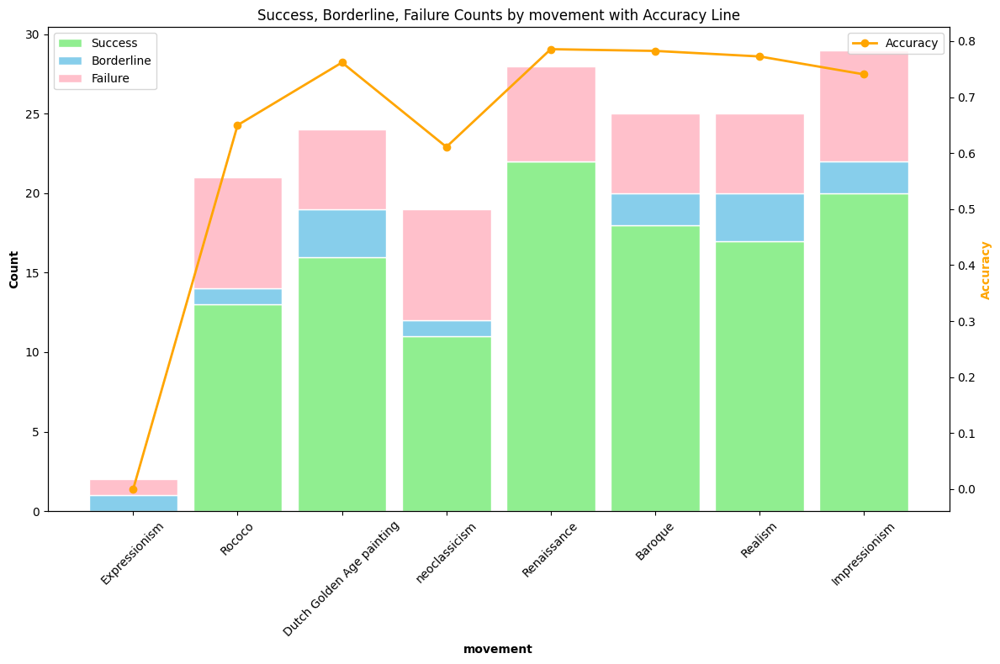

In [ ]:
# visualization of Success, Borderline, Failure Counts by movement with Accuracy Line
movement_test1 = test_df['movement'].values
y_prob1 = best_rf_model.predict_proba(X_test1_pca)[:, 1]

df_results = pd.DataFrame({
    'actual_label': y_test1,
    'predicted_label': y_pred1,
    'movement': movement_test1
})

# define success, failure, borderline

success = df_results[df_results['actual_label'] == df_results['predicted_label']]
failure = df_results[df_results['actual_label'] != df_results['predicted_label']]

borderline = df_results[(df_results['actual_label'] != df_results['predicted_label']) &
                        (y_prob1 > 0.45) & (y_prob1 < 0.55)]

success_movement_count = success['movement'].value_counts()
borderline_movement_count = borderline['movement'].value_counts()
failure_movement_count = failure['movement'].value_counts()

# data prepering
movement_labels = list(set(success_movement_count.index) | set(borderline_movement_count.index) | set(failure_movement_count.index))
success_movement_count = success_movement_count.reindex(movement_labels, fill_value=0)
borderline_movement_count = borderline_movement_count.reindex(movement_labels, fill_value=0)
failure_movement_count = failure_movement_count.reindex(movement_labels, fill_value=0)

# accuracy
total_movement_count = df_results['movement'].value_counts().reindex(movement_labels, fill_value=0)
accuracy_movement = success_movement_count / total_movement_count

# bar plot
barWidth = 0.85
r = np.arange(len(movement_labels))

fig, ax1 = plt.subplots(figsize=(12, 8))

ax1.bar(r, success_movement_count, color='lightgreen', edgecolor='white', width=barWidth, label='Success')
ax1.bar(r, borderline_movement_count, bottom=success_movement_count, color='skyblue', edgecolor='white', width=barWidth, label='Borderline')
ax1.bar(r, failure_movement_count, bottom=success_movement_count+borderline_movement_count, color='pink', edgecolor='white', width=barWidth, label='Failure')

ax1.set_xlabel('movement', fontweight='bold')
ax1.set_ylabel('Count', fontweight='bold')
ax1.set_xticks(r)
ax1.set_xticklabels(movement_labels, rotation=45)
ax1.legend(loc='upper left')

ax2 = ax1.twinx()
ax2.plot(r, accuracy_movement, color='orange', marker='o', linestyle='-', linewidth=2, label='Accuracy')
ax2.set_ylabel('Accuracy', fontweight='bold', color='orange')
ax2.legend(loc='upper right')

plt.title('Success, Borderline, Failure Counts by movement with Accuracy Line')

plt.tight_layout()
plt.show()

In [29]:
y_prob_gram = best_rf_model.predict_proba(X_test1_pca)[:, 1]

In [30]:
df_pg = pd.DataFrame(y_prob_gram, columns=['y_prob_gram'])

# 保存到 CSV 文件
df_pg.to_csv('y_prob_gram.csv', index=False)

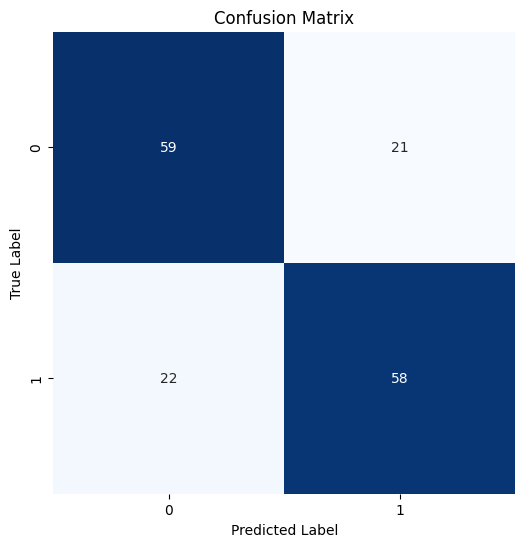

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix

# confusion matrix
cm = confusion_matrix(y_test1, y_pred1)

# Visualize the confusion matrix using a heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", cbar=False, square=True)
plt.title('Confusion Matrix')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()

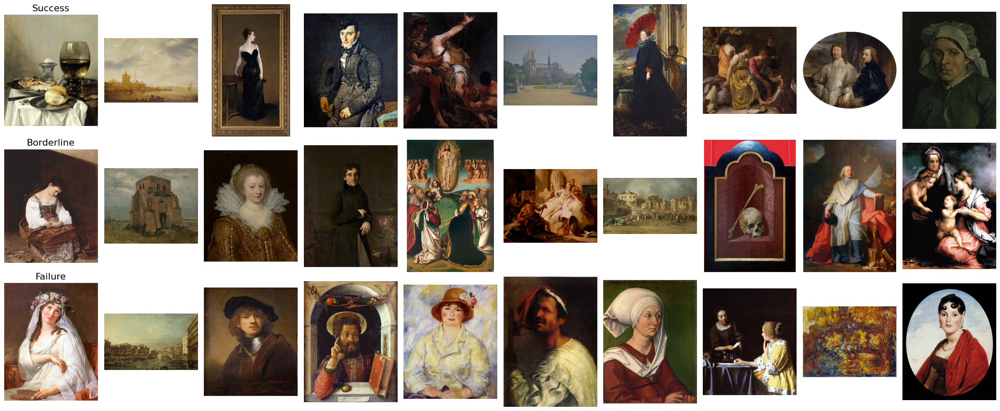

In [ ]:
from matplotlib.offsetbox import OffsetImage, AnnotationBbox

# define the range of borderline
borderline_min = 0.45
borderline_max = 0.55

# define success_indices, failure_indices & borderline_indices
success_indices = np.where(y_test1 == y_pred1)[0]
failure_indices = np.where(y_test1 != y_pred1)[0]
borderline_indices = np.where((y_prob1 > borderline_min) & (y_prob1 < borderline_max))[0]

# Function to download and open the image with updated User-Agent
def download_image(image_url):
    headers = {
        'User-Agent': 'Mozilla/5.0 (Windows NT 10.0; Win64; x64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/115.0.0.0 Safari/537.36',
    }
    try:
        response = requests.get(image_url, headers=headers)
        response.raise_for_status()
        img = Image.open(BytesIO(response.content))
        return img
    except (requests.exceptions.RequestException, UnidentifiedImageError) as e:
        print(f"Could not open image from {image_url}: {e}")
        return None

# Function to add an image to the subplot
def add_image_to_subplot(ax, image_url):
    img = download_image(image_url)
    if img is not None:
        ax.imshow(img)
        ax.axis('off')

# Remove borderline images from success and failure sets
success_set = set(success_indices) - set(borderline_indices)
failure_set = set(failure_indices) - set(borderline_indices)

# Convert back to list and limit to the first 10 images for each category
success_images = list(success_set)[:10]
failure_images = list(failure_set)[:10]
borderline_images = borderline_indices[:10]

# Create a figure for the montage (3 rows, 10 columns)
fig, axs = plt.subplots(3, 10, figsize=(24, 10))

# Plot Success Images (First Row)
for i, idx in enumerate(success_images):
    add_image_to_subplot(axs[0, i % 10], test_df.iloc[idx]['image'])

# Plot Borderline Images (Second Row)
for i, idx in enumerate(borderline_images):
    add_image_to_subplot(axs[1, i % 10], test_df.iloc[idx]['image'])

# Plot Failure Images (Third Row)
for i, idx in enumerate(failure_images):
    add_image_to_subplot(axs[2, i % 10], test_df.iloc[idx]['image'])

# Set titles for rows
axs[0, 0].set_title('Success', fontsize=16)
axs[1, 0].set_title('Borderline', fontsize=16)
axs[2, 0].set_title('Failure', fontsize=16)

# Remove axis for all subplots
for ax in axs.flat:
    ax.axis('off')

plt.tight_layout()
plt.show()

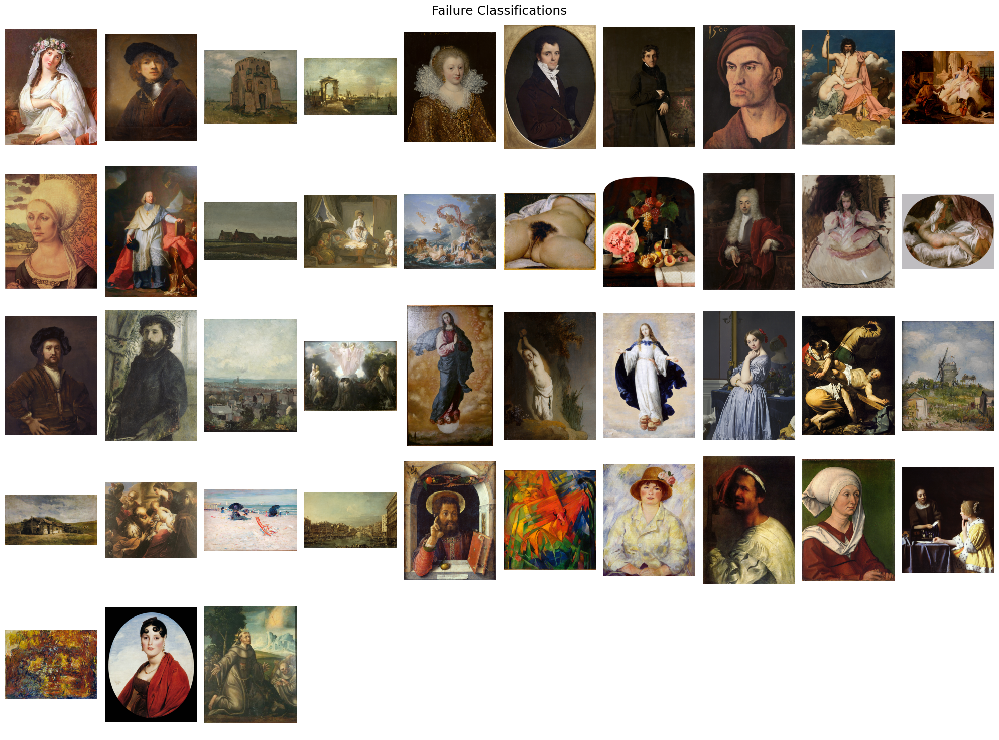

In [ ]:
import matplotlib.pyplot as plt
from matplotlib.offsetbox import OffsetImage, AnnotationBbox
from PIL import Image, UnidentifiedImageError
import requests
from io import BytesIO

# Function to download and open the image with updated User-Agent
def download_image(image_url):
    headers = {
        'User-Agent': 'Mozilla/5.0 (Windows NT 10.0; Win64; x64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/115.0.0.0 Safari/537.36',
    }
    try:
        response = requests.get(image_url, headers=headers)
        response.raise_for_status()
        img = Image.open(BytesIO(response.content))
        return img
    except (requests.exceptions.RequestException, UnidentifiedImageError) as e:
        print(f"Could not open image from {image_url}: {e}")
        return None

# Function to add an image to the subplot
def add_image_to_subplot(ax, image_url):
    img = download_image(image_url)
    if img is not None:
        ax.imshow(img)
        ax.axis('off')

# Define the number of images to display
failure_images = failure_indices

# Create a figure for the montage, with 5 rows and 10 columns
fig, axs = plt.subplots(5, 10, figsize=(20, 15))

# Plot Failure Images (All Rows)
for i, idx in enumerate(failure_images):
    row = i // 10  # Calculate the row index
    col = i % 10   # Calculate the column index
    add_image_to_subplot(axs[row, col], test_df.iloc[idx]['image'])

# Set title for the entire figure
fig.suptitle('Failure Classifications', fontsize=18)

# Remove axis for all subplots
for ax in axs.flat:
    ax.axis('off')

plt.tight_layout()
plt.show()


In [ ]:
# save failed images
failure_data = test_df.iloc[failure_indices].copy()
failure_data['actual_label'] = y_test1[failure_indices]
failure_data['predicted_label'] = y_pred1[failure_indices]

failure_data_to_save = failure_data[['image', 'actual_label', 'predicted_label','movement','genre']]

failure_data_to_save.to_csv('gram_failures.csv', index=False)

print("Gram Failed classification data saved to classification_failures.csv")

Gram Failed classification data saved to classification_failures.csv


In [ ]:
# save boderline images
borderline_data = test_df.iloc[borderline_indices].copy()
borderline_data['actual_label'] = y_test1[borderline_indices]
borderline_data['predicted_label'] = y_pred1[borderline_indices]

borderline_data_to_save = borderline_data[['image', 'actual_label', 'predicted_label','movement','genre']]

borderline_data_to_save.to_csv('gram_borderlines.csv', index=False)

print("Gram Borderline classification data saved to classification_borderlines.csv")

Gram Borderline classification data saved to classification_borderlines.csv


In [ ]:
# save succeed images
success_data = test_df.iloc[success_indices].copy()
success_data['actual_label'] = y_test1[success_indices]
success_data['predicted_label'] = y_pred1[success_indices]

success_data_to_save = success_data[['image', 'actual_label', 'predicted_label','movement','genre']]

success_data_to_save.to_csv('gram_successs.csv', index=False)

print("Gram succeed classification data saved to classification_successs.csv")

Gram succeed classification data saved to classification_successs.csv


In [50]:
# Combined
y_train2 = train_df['influenced'].values
y_test2 = test_df['influenced'].values

In [51]:
# concatenate ResNet and Gram features
X_train2_pca2 = np.hstack((X_train_pca, X_train1_pca))
X_test2_pca2 = np.hstack((X_test_pca, X_test1_pca))

print(f"Combined training set shape: {X_train2_pca2.shape}")
print(f"Combined test set shape: {X_test2_pca2.shape}")

Combined training set shape: (640, 84)
Combined test set shape: (160, 84)


In [52]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import accuracy_score, classification_report

In [53]:
# define grid
param_grid = {
    'n_estimators': [100, 200, 300],
    'max_depth': [None, 10, 20, 30],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'bootstrap': [True, False]
}

# rf
rf = RandomForestClassifier(random_state=42)

# GridSearchCV
grid_search = GridSearchCV(estimator=rf, param_grid=param_grid, cv=5, n_jobs=-1, verbose=2)
grid_search.fit(X_train2_pca2, y_train2)

print(f"Best Parameters: {grid_search.best_params_}")
print(f"Best Cross-Validation Score: {grid_search.best_score_}")

# predict
best_rf_model = grid_search.best_estimator_
y_pred2 = best_rf_model.predict(X_test2_pca2)

print("Accuracy:", accuracy_score(y_test2, y_pred2))
print("Classification Report:\n", classification_report(y_test2, y_pred2))


Fitting 5 folds for each of 216 candidates, totalling 1080 fits
Best Parameters: {'bootstrap': True, 'max_depth': None, 'min_samples_leaf': 1, 'min_samples_split': 10, 'n_estimators': 300}
Best Cross-Validation Score: 0.69375
Accuracy: 0.7375
Classification Report:
               precision    recall  f1-score   support

           0       0.73      0.76      0.74        80
           1       0.75      0.71      0.73        80

    accuracy                           0.74       160
   macro avg       0.74      0.74      0.74       160
weighted avg       0.74      0.74      0.74       160



In [56]:
y_prob2 = best_rf_model.predict_proba(X_test2_pca2)[:, 1]
df_pc = pd.DataFrame(y_prob2, columns=['y_prob2'])

# 保存到 CSV 文件
df_pc.to_csv('y_prob_combined.csv', index=False)

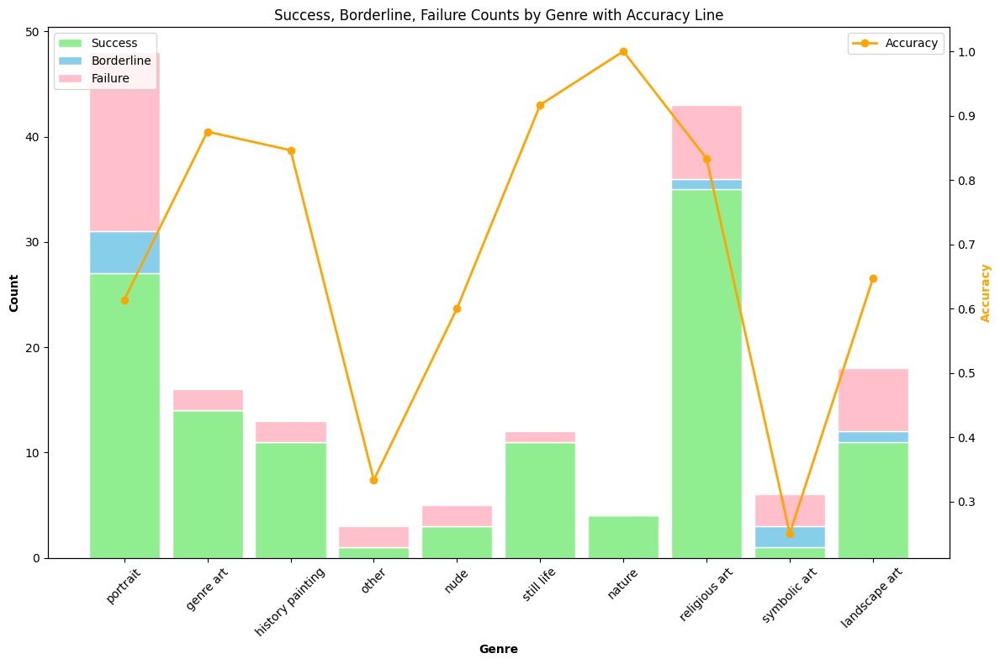

In [ ]:
# visualization of Success, Borderline, Failure Counts by Genre with Accuracy Line
genre_test2 = test_df['genre'].values
y_prob2 = best_rf_model.predict_proba(X_test2_pca2)[:, 1]

df_results = pd.DataFrame({
    'actual_label': y_test2,
    'predicted_label': y_pred2,
    'genre': genre_test2
})

# define success, failure, borderline

success = df_results[df_results['actual_label'] == df_results['predicted_label']]
failure = df_results[df_results['actual_label'] != df_results['predicted_label']]

borderline = df_results[(df_results['actual_label'] != df_results['predicted_label']) &
                        (y_prob2 > 0.45) & (y_prob2 < 0.55)]

success_genre_count = success['genre'].value_counts()
borderline_genre_count = borderline['genre'].value_counts()
failure_genre_count = failure['genre'].value_counts()

# data prepering
genre_labels = list(set(success_genre_count.index) | set(borderline_genre_count.index) | set(failure_genre_count.index))
success_genre_count = success_genre_count.reindex(genre_labels, fill_value=0)
borderline_genre_count = borderline_genre_count.reindex(genre_labels, fill_value=0)
failure_genre_count = failure_genre_count.reindex(genre_labels, fill_value=0)

# accuracy
total_genre_count = df_results['genre'].value_counts().reindex(genre_labels, fill_value=0)
accuracy_genre = success_genre_count / total_genre_count

# bar plot
barWidth = 0.85
r = np.arange(len(genre_labels))

fig, ax1 = plt.subplots(figsize=(12, 8))

ax1.bar(r, success_genre_count, color='lightgreen', edgecolor='white', width=barWidth, label='Success')
ax1.bar(r, borderline_genre_count, bottom=success_genre_count, color='skyblue', edgecolor='white', width=barWidth, label='Borderline')
ax1.bar(r, failure_genre_count, bottom=success_genre_count+borderline_genre_count, color='pink', edgecolor='white', width=barWidth, label='Failure')

ax1.set_xlabel('Genre', fontweight='bold')
ax1.set_ylabel('Count', fontweight='bold')
ax1.set_xticks(r)
ax1.set_xticklabels(genre_labels, rotation=45)
ax1.legend(loc='upper left')

ax2 = ax1.twinx()
ax2.plot(r, accuracy_genre, color='orange', marker='o', linestyle='-', linewidth=2, label='Accuracy')
ax2.set_ylabel('Accuracy', fontweight='bold', color='orange')
ax2.legend(loc='upper right')

plt.title('Success, Borderline, Failure Counts by Genre with Accuracy Line')

plt.tight_layout()
plt.show()

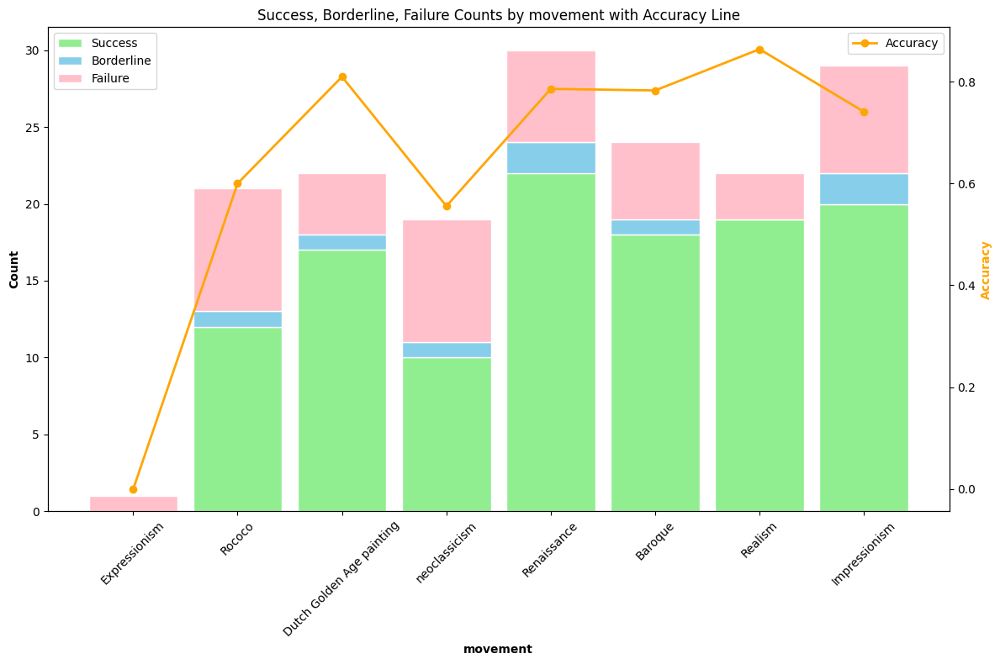

In [ ]:
# visualization of Success, Borderline, Failure Counts by movement with Accuracy Line
movement_test2 = test_df['movement'].values
y_prob2 = best_rf_model.predict_proba(X_test2_pca2)[:, 1]

df_results = pd.DataFrame({
    'actual_label': y_test2,
    'predicted_label': y_pred2,
    'movement': movement_test2
})

# define success, failure, borderline

success = df_results[df_results['actual_label'] == df_results['predicted_label']]
failure = df_results[df_results['actual_label'] != df_results['predicted_label']]

borderline = df_results[(df_results['actual_label'] != df_results['predicted_label']) &
                        (y_prob2 > 0.45) & (y_prob2 < 0.55)]

success_movement_count = success['movement'].value_counts()
borderline_movement_count = borderline['movement'].value_counts()
failure_movement_count = failure['movement'].value_counts()

# data prepering
movement_labels = list(set(success_movement_count.index) | set(borderline_movement_count.index) | set(failure_movement_count.index))
success_movement_count = success_movement_count.reindex(movement_labels, fill_value=0)
borderline_movement_count = borderline_movement_count.reindex(movement_labels, fill_value=0)
failure_movement_count = failure_movement_count.reindex(movement_labels, fill_value=0)

# accuracy
total_movement_count = df_results['movement'].value_counts().reindex(movement_labels, fill_value=0)
accuracy_movement = success_movement_count / total_movement_count

# bar plot
barWidth = 0.85
r = np.arange(len(movement_labels))

fig, ax1 = plt.subplots(figsize=(12, 8))

ax1.bar(r, success_movement_count, color='lightgreen', edgecolor='white', width=barWidth, label='Success')
ax1.bar(r, borderline_movement_count, bottom=success_movement_count, color='skyblue', edgecolor='white', width=barWidth, label='Borderline')
ax1.bar(r, failure_movement_count, bottom=success_movement_count+borderline_movement_count, color='pink', edgecolor='white', width=barWidth, label='Failure')

ax1.set_xlabel('movement', fontweight='bold')
ax1.set_ylabel('Count', fontweight='bold')
ax1.set_xticks(r)
ax1.set_xticklabels(movement_labels, rotation=45)
ax1.legend(loc='upper left')

ax2 = ax1.twinx()
ax2.plot(r, accuracy_movement, color='orange', marker='o', linestyle='-', linewidth=2, label='Accuracy')
ax2.set_ylabel('Accuracy', fontweight='bold', color='orange')
ax2.legend(loc='upper right')

plt.title('Success, Borderline, Failure Counts by movement with Accuracy Line')

plt.tight_layout()
plt.show()

In [ ]:
# define the range of borderline
borderline_min = 0.45
borderline_max = 0.55

# define success_indices, failure_indices and borderline_indices
success_indices = np.where(y_test2 == y_pred2)[0]
failure_indices = np.where(y_test2 != y_pred2)[0]
borderline_indices = np.where((y_prob2 > borderline_min) & (y_prob2 < borderline_max))[0]

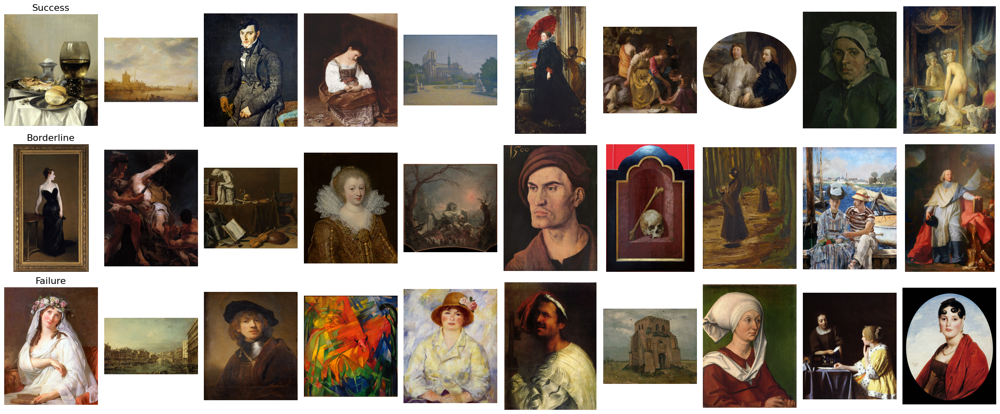

In [ ]:
import matplotlib.pyplot as plt
from matplotlib.offsetbox import OffsetImage, AnnotationBbox
from PIL import Image, UnidentifiedImageError
import requests
from io import BytesIO

# Function to download and open the image with updated User-Agent
def download_image(image_url):
    headers = {
        'User-Agent': 'Mozilla/5.0 (Windows NT 10.0; Win64; x64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/115.0.0.0 Safari/537.36',
    }
    try:
        response = requests.get(image_url, headers=headers)
        response.raise_for_status()
        img = Image.open(BytesIO(response.content))
        return img
    except (requests.exceptions.RequestException, UnidentifiedImageError) as e:
        print(f"Could not open image from {image_url}: {e}")
        return None

# Function to add an image to the subplot
def add_image_to_subplot(ax, image_url):
    img = download_image(image_url)
    if img is not None:
        ax.imshow(img)
        ax.axis('off')

# Remove borderline images from success and failure sets
success_set = set(success_indices) - set(borderline_indices)
failure_set = set(failure_indices) - set(borderline_indices)

# Convert back to list and limit to the first 10 images for each category
success_images = list(success_set)[:10]
failure_images = list(failure_set)[:10]
borderline_images = borderline_indices[:10]

# Create a figure for the montage (3 rows, 10 columns)
fig, axs = plt.subplots(3, 10, figsize=(24, 10))

# Plot Success Images (First Row)
for i, idx in enumerate(success_images):
    add_image_to_subplot(axs[0, i % 10], test_df.iloc[idx]['image'])

# Plot Borderline Images (Second Row)
for i, idx in enumerate(borderline_images):
    add_image_to_subplot(axs[1, i % 10], test_df.iloc[idx]['image'])

# Plot Failure Images (Third Row)
for i, idx in enumerate(failure_images):
    add_image_to_subplot(axs[2, i % 10], test_df.iloc[idx]['image'])

# Set titles for rows
axs[0, 0].set_title('Success', fontsize=16)
axs[1, 0].set_title('Borderline', fontsize=16)
axs[2, 0].set_title('Failure', fontsize=16)

# Remove axis for all subplots
for ax in axs.flat:
    ax.axis('off')

plt.tight_layout()
plt.show()

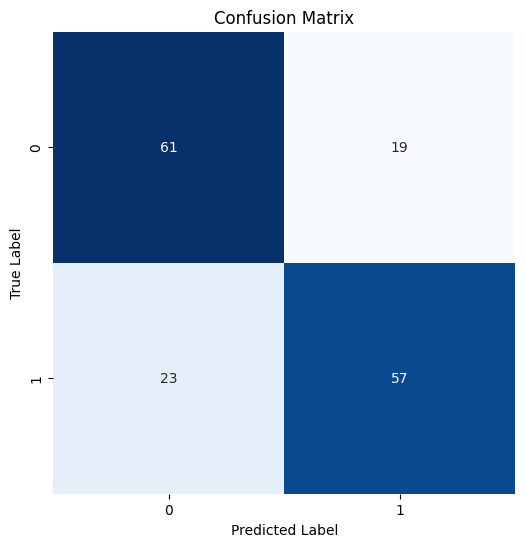

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix

# confusion matrix
cm = confusion_matrix(y_test2, y_pred2)

# Visualize the confusion matrix using a heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", cbar=False, square=True)
plt.title('Confusion Matrix')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()


In [ ]:
pip install --upgrade Pillow

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.5/4.5 MB 34.5 MB/s eta 0:00:00
  Attempting uninstall: Pillow
    Found existing installation: Pillow 9.4.0
    Uninstalling Pillow-9.4.0:
      Successfully uninstalled Pillow-9.4.0


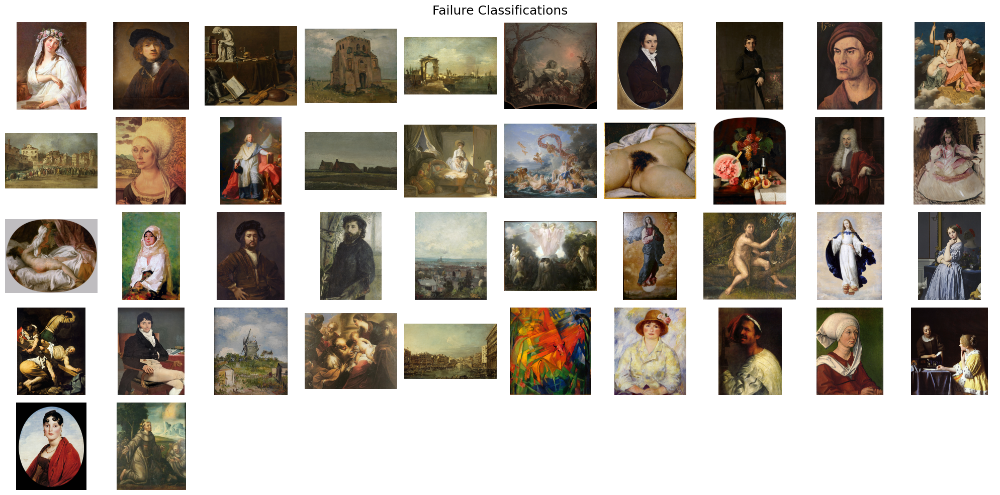

In [ ]:
# Function to download and open the image with updated User-Agent
def download_image(image_url):
    headers = {
        'User-Agent': 'Mozilla/5.0 (Windows NT 10.0; Win64; x64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/115.0.0.0 Safari/537.36',
    }
    try:
        response = requests.get(image_url, headers=headers)
        response.raise_for_status()
        img = Image.open(BytesIO(response.content))
        return img
    except (requests.exceptions.RequestException, UnidentifiedImageError) as e:
        print(f"Could not open image from {image_url}: {e}")
        return None

# Function to add an image to the subplot
def add_image_to_subplot(ax, image_url):
    img = download_image(image_url)
    if img is not None:
        ax.imshow(img)
        ax.axis('off')

# Define the number of images to display (50 failure images)
failure_images = failure_indices  # Only showing the first 50 failure images

# Create a figure for the montage, with 5 rows and 10 columns
fig, axs = plt.subplots(5, 10, figsize=(20, 10))

# Plot Failure Images (All Rows)
for i, idx in enumerate(failure_images):
    row = i // 10  # Calculate the row index
    col = i % 10   # Calculate the column index
    add_image_to_subplot(axs[row, col], test_df.iloc[idx]['image'])

# Set title for the entire figure
fig.suptitle('Failure Classifications', fontsize=18)

# Remove axis for all subplots
for ax in axs.flat:
    ax.axis('off')

plt.tight_layout()
plt.show()

In [ ]:
# save failed images
failure_data = test_df.iloc[failure_indices].copy()
failure_data['actual_label'] = y_test2[failure_indices]
failure_data['predicted_label'] = y_pred2[failure_indices]

failure_data_to_save = failure_data[['image', 'actual_label', 'predicted_label','movement','genre']]
failure_data_to_save.to_csv('combined_failures.csv', index=False)

print("Combined Failed classification data saved to classification_failures.csv")

Combined Failed classification data saved to classification_failures.csv


In [ ]:
# save success images
success_data = test_df.iloc[success_indices].copy()
success_data['actual_label'] = y_test2[success_indices]
success_data['predicted_label'] = y_pred2[success_indices]

success_data_to_save = success_data[['image', 'actual_label', 'predicted_label','movement','genre']]
success_data_to_save.to_csv('combined_successs.csv', index=False)

print("Combined Succeed classification data saved to classification_successs.csv")

Combined Failed classification data saved to classification_successs.csv


In [ ]:
# save borderline images
borderline_data = test_df.iloc[borderline_indices].copy()
borderline_data['actual_label'] = y_test2[borderline_indices]
borderline_data['predicted_label'] = y_pred2[borderline_indices]

borderline_data_to_save = borderline_data[['image', 'actual_label', 'predicted_label','movement','genre']]
borderline_data_to_save.to_csv('combined_borderlines.csv', index=False)

print("Combined boderline classification data saved to classification_borderlines.csv")

Combined boderline classification data saved to classification_borderlines.csv


In [8]:
from PIL import Image
import urllib.request
from matplotlib.gridspec import GridSpec

# calculate the Intersection and difference of three failure datasets
resnet_failures = pd.read_csv('resnet_failures.csv')
gram_failures = pd.read_csv('gram_failures.csv')
combined_failures = pd.read_csv('combined_failures.csv')

failed_indices_resnet = set(resnet_failures.index)
failed_indices_gram = set(gram_failures.index)
failed_indices_combined = set(combined_failures.index)

unique_failures_resnet = failed_indices_resnet - (failed_indices_gram | failed_indices_combined)
unique_failures_gram = failed_indices_gram - (failed_indices_resnet | failed_indices_combined)
unique_failures_combined = failed_indices_combined - (failed_indices_resnet | failed_indices_gram)

resnet_gram_failures = failed_indices_resnet & failed_indices_gram
resnet_combined_failures = failed_indices_resnet & failed_indices_combined
gram_combined_failures = failed_indices_gram & failed_indices_combined

print(f"Number of unique failures in ResNet: {len(unique_failures_resnet)}")
print(f"Number of unique failures in Gram: {len(unique_failures_gram)}")
print(f"Number of unique failures in Combined: {len(unique_failures_combined)}")
print(f"Number of ResNet and Gram common failures: {len(resnet_gram_failures)}")
print(f"Number of ResNet and Combined common failures: {len(resnet_combined_failures)}")
print(f"Number of Gram and Combined common failures: {len(gram_combined_failures)}")

Number of unique failures in ResNet: 0
Number of unique failures in Gram: 1
Number of unique failures in Combined: 0
Number of ResNet and Gram common failures: 41
Number of ResNet and Combined common failures: 41
Number of Gram and Combined common failures: 42


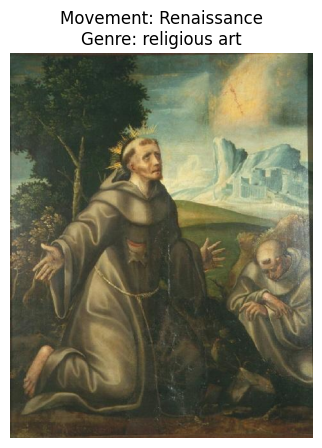

In [10]:
from PIL import Image
import requests
from io import BytesIO
import matplotlib.pyplot as plt

# Define request headers
headers = {
    'User-Agent': 'Mozilla/5.0 (Windows NT 10.15; Intel Mac OS X 10_15_7) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/91.0.4472.114 Safari/537.36',
    'Referer': 'https://www.google.com'
}

# Extract the index of the unique failure from the Gram model
if len(unique_failures_gram) > 0:
    unique_gram_index = list(unique_failures_gram)[0]  # Assume there is only one unique failure
    unique_gram_data = gram_failures.loc[unique_gram_index]

    # Extract image URL, movement, and genre information
    image_url = unique_gram_data['image']
    movement = unique_gram_data['movement']
    genre = unique_gram_data['genre']

    # Download and display the image
    try:
        response = requests.get(image_url, headers=headers)  # Add headers to the request
        response.raise_for_status()  # Check if the request was successful
        img = Image.open(BytesIO(response.content))

        # Set up the plot and title
        fig, ax = plt.subplots(figsize=(5, 5))
        ax.imshow(img)
        ax.axis('off')  # Hide axis
        ax.set_title(f"Movement: {movement}\nGenre: {genre}")

        plt.show()

    except requests.exceptions.RequestException as e:
        print(f"Error fetching image: {e}")
else:
    print("No unique failures in the Gram model.")

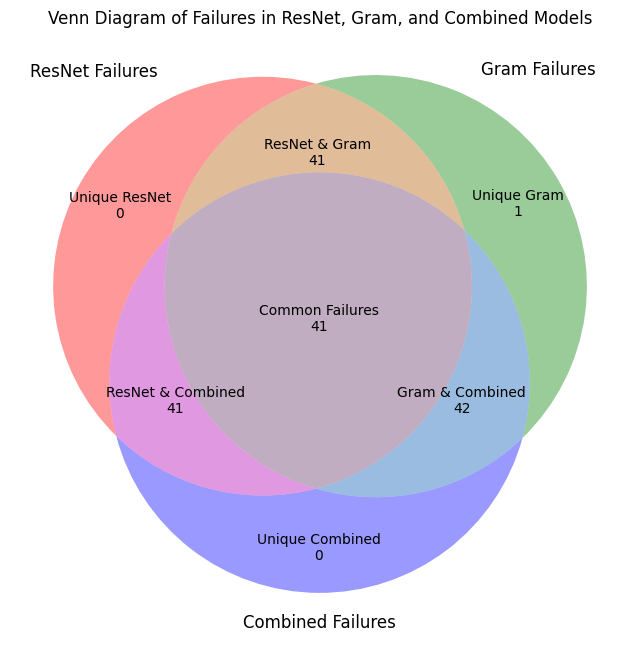

In [ ]:
from matplotlib_venn import venn3

# Define the subsets for the Venn diagram
venn_data = {
    '100': len(unique_failures_resnet),  # Only in ResNet
    '010': len(unique_failures_gram),    # Only in Gram
    '001': len(unique_failures_combined),  # Only in Combined
    '110': len(resnet_gram_failures),    # In ResNet and Gram
    '101': len(resnet_combined_failures),  # In ResNet and Combined
    '011': len(gram_combined_failures),  # In Gram and Combined
    '111': len(failed_indices_resnet & failed_indices_gram & failed_indices_combined)  # In all three
}

# Create the Venn diagram
plt.figure(figsize=(8, 8))
venn = venn3(subsets=venn_data, set_labels=('ResNet Failures', 'Gram Failures', 'Combined Failures'))

# Customize plot (optional)
venn.get_label_by_id('100').set_text(f'Unique ResNet\n{venn_data["100"]}')
venn.get_label_by_id('010').set_text(f'Unique Gram\n{venn_data["010"]}')
venn.get_label_by_id('001').set_text(f'Unique Combined\n{venn_data["001"]}')
venn.get_label_by_id('110').set_text(f'ResNet & Gram\n{venn_data["110"]}')
venn.get_label_by_id('101').set_text(f'ResNet & Combined\n{venn_data["101"]}')
venn.get_label_by_id('011').set_text(f'Gram & Combined\n{venn_data["011"]}')
venn.get_label_by_id('111').set_text(f'Common Failures\n{venn_data["111"]}')

# Show plot
plt.title("Venn Diagram of Failures in ResNet, Gram, and Combined Models")
plt.show()


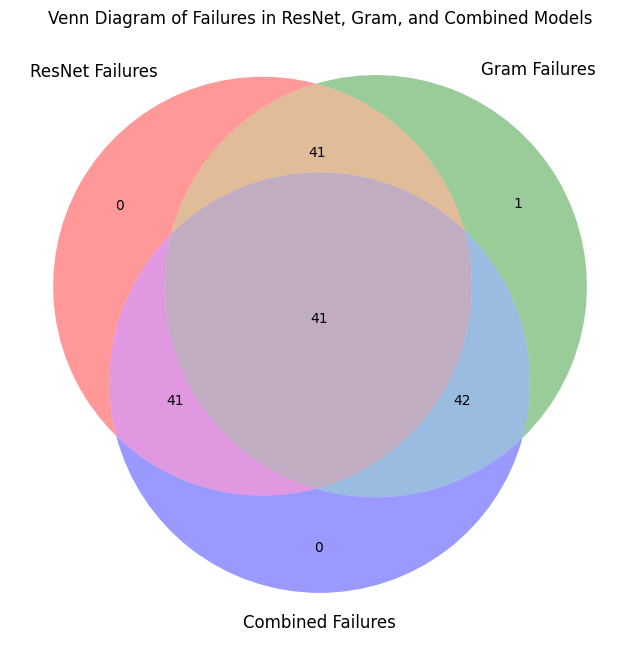

In [ ]:
# Define the subsets for the Venn diagram
venn_data = {
    '100': len(unique_failures_resnet),  # Only in ResNet
    '010': len(unique_failures_gram),    # Only in Gram
    '001': len(unique_failures_combined),  # Only in Combined
    '110': len(resnet_gram_failures),    # In ResNet and Gram
    '101': len(resnet_combined_failures),  # In ResNet and Combined
    '011': len(gram_combined_failures),  # In Gram and Combined
    '111': len(failed_indices_resnet & failed_indices_gram & failed_indices_combined)  # In all three
}

# Create the Venn diagram
plt.figure(figsize=(8, 8))
venn = venn3(subsets=venn_data, set_labels=('ResNet Failures', 'Gram Failures', 'Combined Failures'))

# Show plot
plt.title("Venn Diagram of Failures in ResNet, Gram, and Combined Models")
plt.show()

In [ ]:
print(test_df.head)

<bound method NDFrame.head of            wid                                              label  influenced  \
696  Q17341089                      Still life with a salt cellar       False   
667  Q17334160                        River view with sentry post       False   
63    Q2664039                               Portrait of Madame X       False   
533  Q18518827  Musée Ingres-Bourdelle - Portrait de Jean-Pier...        True   
66    Q2732274                                 Penitent Magdalene       False   
..         ...                                                ...         ...   
589  Q72398520                                                NaN       False   
798  Q15918393                                     La Belle Zélie        True   
744   Q1114220                          Poppy Field near Vétheuil       False   
513  Q66088030                            Saint Francis of Assisi       False   
670  Q26242941                            Head of a Peasant Woman        True  

In [ ]:
len(test_df)

160

In [ ]:
# Copy the column and rename it
test_df['influenced'] = test_df['actual_label']

# Verify the column has been copied and renamed
print(test_df.head())

                                               image  actual_label  \
0  https://upload.wikimedia.org/wikipedia/commons...             0   
1  https://upload.wikimedia.org/wikipedia/commons...             0   
2  https://upload.wikimedia.org/wikipedia/commons...             0   
3  https://upload.wikimedia.org/wikipedia/commons...             1   
4  https://upload.wikimedia.org/wikipedia/commons...             0   

   predicted_label                   movement          genre  influenced  
0                0  Dutch Golden Age painting     still life           0  
1                0  Dutch Golden Age painting  landscape art           0  
2                0                    Realism       portrait           0  
3                1              neoclassicism       portrait           1  
4                0                    Baroque  religious art           0  


In [ ]:
movement_influenced_distribution = test_df.groupby(['movement', 'influenced']).size().unstack(fill_value=0)

print(movement_influenced_distribution)

influenced                 False  True 
movement                               
Baroque                       10     13
Dutch Golden Age painting     18      3
Expressionism                  0      1
Impressionism                 13     14
Realism                        4     18
Renaissance                   22      6
Rococo                         4     16
neoclassicism                  9      9


In [ ]:
movement_influenced = test_df.groupby(['movement', 'influenced']).size().unstack().fillna(0)
print(movement_influenced)

influenced                 False  True 
movement                               
Baroque                     10.0   13.0
Dutch Golden Age painting   18.0    3.0
Expressionism                0.0    1.0
Impressionism               13.0   14.0
Realism                      4.0   18.0
Renaissance                 22.0    6.0
Rococo                       4.0   16.0
neoclassicism                9.0    9.0


In [ ]:
movement_influenced = train_df.groupby(['movement', 'influenced']).size().unstack().fillna(0)
print(movement_influenced)

influenced                 False  True 
movement                               
Baroque                       43     81
Dutch Golden Age painting     54     18
Expressionism                  2      9
Impressionism                 48     61
Realism                       20     57
Renaissance                  112     27
Rococo                        16     39
neoclassicism                 25     28


In [ ]:
genre_influenced = train_df.groupby(['genre', 'influenced']).size().unstack().fillna(0)
print(genre_influenced)

influenced        False  True 
genre                         
genre art            20     41
history painting     24     28
landscape art        46     34
nature               10      7
nude                 10     17
other                 5      9
portrait             60    118
religious art       124     40
still life           13     18
symbolic art          8      8


<Figure size 640x480 with 0 Axes>

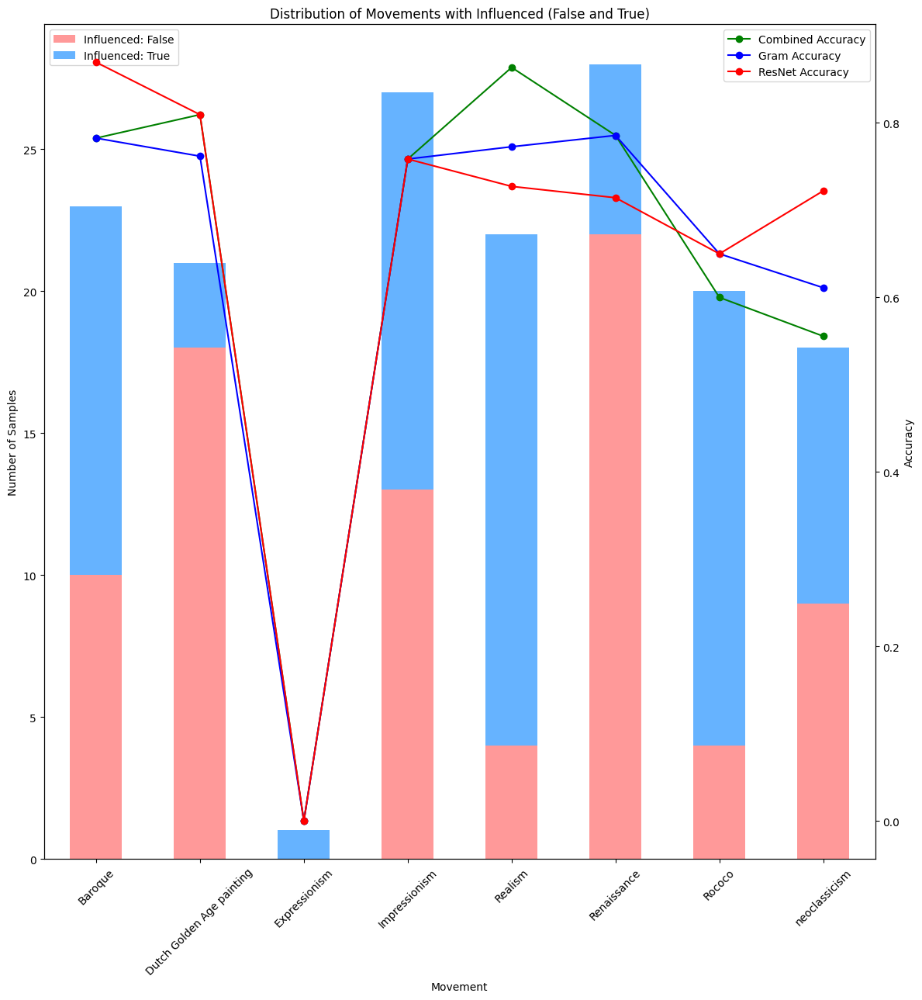

In [22]:
# Load the success and failure datasets for each model
combined_success = pd.read_csv('combined_successs.csv')
combined_failure = pd.read_csv('combined_failures.csv')

gram_success = pd.read_csv('gram_successs.csv')
gram_failure = pd.read_csv('gram_failures.csv')

resnet_success = pd.read_csv('resnet_successs.csv')
resnet_failure = pd.read_csv('resnet_failures.csv')

# Merge all success and failure datasets with test_df to get the 'influenced' column only
combined_success = pd.merge(combined_success, test_df[['image', 'influenced']], on='image', how='left')
combined_failure = pd.merge(combined_failure, test_df[['image', 'influenced']], on='image', how='left')

gram_success = pd.merge(gram_success, test_df[['image', 'influenced']], on='image', how='left')
gram_failure = pd.merge(gram_failure, test_df[['image', 'influenced']], on='image', how='left')

resnet_success = pd.merge(resnet_success, test_df[['image', 'influenced']], on='image', how='left')
resnet_failure = pd.merge(resnet_failure, test_df[['image', 'influenced']], on='image', how='left')

# Now we calculate the classification accuracy for each movement for each model
movements = test_df['movement'].unique()
accuracy_combined = []
accuracy_gram = []
accuracy_resnet = []

# For combined model
for movement in movements:
    combined_movement_success = combined_success[combined_success['movement'] == movement]
    combined_movement_failure = combined_failure[combined_failure['movement'] == movement]
    combined_total = len(combined_movement_success) + len(combined_movement_failure)
    accuracy_combined.append(len(combined_movement_success) / combined_total if combined_total != 0 else 0)

# For gram model
for movement in movements:
    gram_movement_success = gram_success[gram_success['movement'] == movement]
    gram_movement_failure = gram_failure[gram_failure['movement'] == movement]
    gram_total = len(gram_movement_success) + len(gram_movement_failure)
    accuracy_gram.append(len(gram_movement_success) / gram_total if gram_total != 0 else 0)

# For resnet model
for movement in movements:
    resnet_movement_success = resnet_success[resnet_success['movement'] == movement]
    resnet_movement_failure = resnet_failure[resnet_failure['movement'] == movement]
    resnet_total = len(resnet_movement_success) + len(resnet_movement_failure)
    accuracy_resnet.append(len(resnet_movement_success) / resnet_total if resnet_total != 0 else 0)

# Plot the stacked bar chart of influenced distribution (from test_df directly)
movement_influenced = test_df.groupby(['movement', 'influenced']).size().unstack().fillna(0)

# Sort the movements based on the order of movement_influenced
movements_order = movement_influenced.index

accuracy_combined = [accuracy_combined[movements.tolist().index(movement)] for movement in movements_order]
accuracy_gram = [accuracy_gram[movements.tolist().index(movement)] for movement in movements_order]
accuracy_resnet = [accuracy_resnet[movements.tolist().index(movement)] for movement in movements_order]

# plot
plt.clf()
fig, ax1 = plt.subplots(figsize=(12, 13))

# Plot the stacked bar chart for movement distribution with influenced variable (from test_df)
movement_influenced.plot(kind='bar', stacked=True, ax=ax1, color=['#ff9999', '#66b3ff'],rot=45)
ax1.set_xlabel('Movement')
ax1.set_ylabel('Number of Samples')
ax1.set_title('Distribution of Movements with Influenced (False and True)')

# Add legend for influenced categories
ax1.legend(['Influenced: False', 'Influenced: True'], loc='upper left')

# Create a secondary axis to plot the accuracy lines
ax2 = ax1.twinx()

x = np.arange(len(movements_order))

# Plot the classification accuracy lines for each model
ax2.plot(x, accuracy_combined, color='green', marker='o', label='Combined Accuracy')
ax2.plot(x, accuracy_gram, color='blue', marker='o', label='Gram Accuracy')
ax2.plot(x, accuracy_resnet, color='red', marker='o', label='ResNet Accuracy')

ax2.set_ylabel('Accuracy')
ax2.legend(loc='upper right')

# Ensure the x-axis labels are rotated properly
plt.xticks(x, movements_order, rotation=45)

# Display the plot with proper x-axis labels and layout
plt.tight_layout()
plt.show()

In [70]:
print(len(combined_success))
print(len(combined_failure))
print(len(gram_success))
print(len(gram_failure))
print(len(resnet_success))
print(len(resnet_failure))

120
42
119
43
121
41


<Figure size 640x480 with 0 Axes>

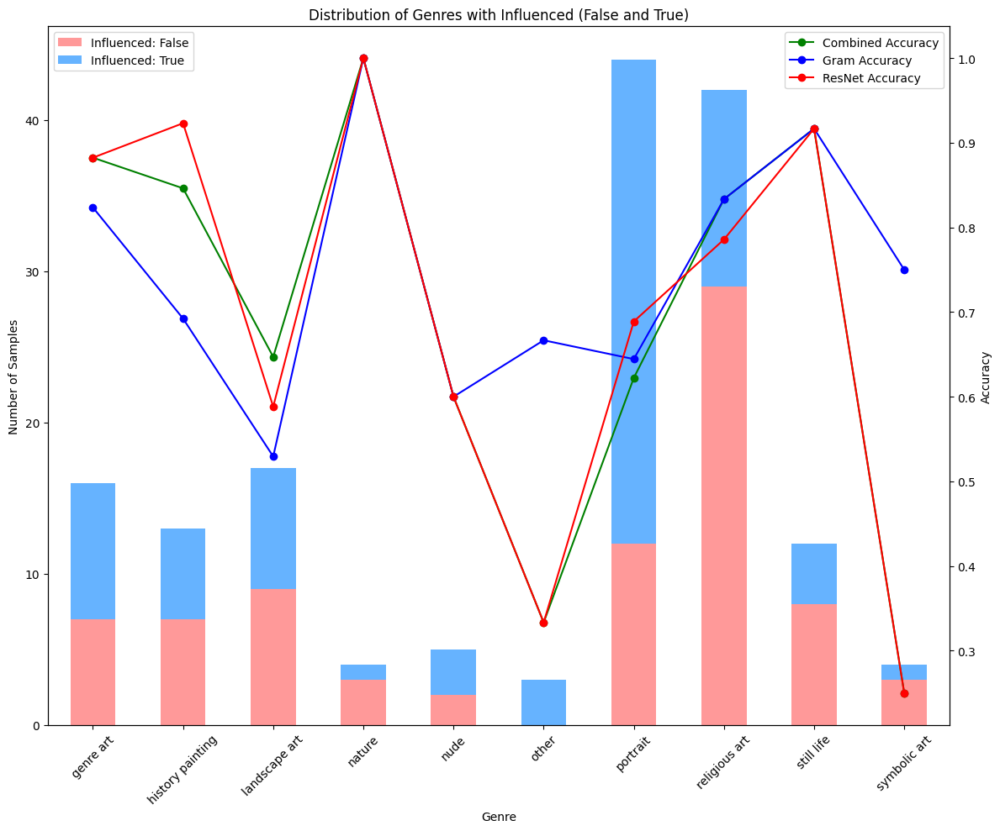

In [ ]:
# Plotting based on genre

# 1. Group data by genre and influenced to calculate genre distribution
genre_influenced = test_df.groupby(['genre', 'influenced']).size().unstack().fillna(0)

# 2. Get unique genres
genres = test_df['genre'].unique()

# 3. Initialize accuracy lists for each model
accuracy_combined_genre = []
accuracy_gram_genre = []
accuracy_resnet_genre = []

# 4. Calculate the classification accuracy for each genre for each model
# For combined model
for genre in genres:
    combined_genre_success = combined_success[combined_success['genre'] == genre]
    combined_genre_failure = combined_failure[combined_failure['genre'] == genre]
    combined_total = len(combined_genre_success) + len(combined_genre_failure)
    accuracy_combined_genre.append(len(combined_genre_success) / combined_total if combined_total != 0 else 0)

# For gram model
for genre in genres:
    gram_genre_success = gram_success[gram_success['genre'] == genre]
    gram_genre_failure = gram_failure[gram_failure['genre'] == genre]
    gram_total = len(gram_genre_success) + len(gram_genre_failure)
    accuracy_gram_genre.append(len(gram_genre_success) / gram_total if gram_total != 0 else 0)

# For resnet model
for genre in genres:
    resnet_genre_success = resnet_success[resnet_success['genre'] == genre]
    resnet_genre_failure = resnet_failure[resnet_failure['genre'] == genre]
    resnet_total = len(resnet_genre_success) + len(resnet_genre_failure)
    accuracy_resnet_genre.append(len(resnet_genre_success) / resnet_total if resnet_total != 0 else 0)

# 5. Sort genres based on the order of genre_influenced
genres_order = genre_influenced.index

# 6. Align accuracy lists to match the genre order
accuracy_combined_genre = [accuracy_combined_genre[genres.tolist().index(genre)] for genre in genres_order]
accuracy_gram_genre = [accuracy_gram_genre[genres.tolist().index(genre)] for genre in genres_order]
accuracy_resnet_genre = [accuracy_resnet_genre[genres.tolist().index(genre)] for genre in genres_order]

# 7. Plotting the genre distribution with influenced categories and accuracy lines
plt.clf()
fig, ax1 = plt.subplots(figsize=(12, 10))

# Plot the stacked bar chart for genre distribution with influenced variable
genre_influenced.plot(kind='bar', stacked=True, ax=ax1, color=['#ff9999', '#66b3ff'], rot=45)
ax1.set_xlabel('Genre')
ax1.set_ylabel('Number of Samples')
ax1.set_title('Distribution of Genres with Influenced (False and True)')

# Add legend for influenced categories
ax1.legend(['Influenced: False', 'Influenced: True'], loc='upper left')

# Create a secondary axis to plot the accuracy lines
ax2 = ax1.twinx()

x = np.arange(len(genres_order))

# Plot the classification accuracy lines for each model
ax2.plot(x, accuracy_combined_genre, color='green', marker='o', label='Combined Accuracy')
ax2.plot(x, accuracy_gram_genre, color='blue', marker='o', label='Gram Accuracy')
ax2.plot(x, accuracy_resnet_genre, color='red', marker='o', label='ResNet Accuracy')

ax2.set_ylabel('Accuracy')
ax2.legend(loc='upper right')

# Ensure the x-axis labels are rotated properly
plt.xticks(x, genres_order, rotation=45)

# Display the plot with proper x-axis labels and layout
plt.tight_layout()
plt.show()

In [ ]:
resnet_borderlines = pd.read_csv('resnet_borderlines.csv')
gram_borderlines = pd.read_csv('gram_borderlines.csv')
combined_borderlines = pd.read_csv('combined_borderlines.csv')

# 1. Calculate the proportion of borderline samples
def calculate_borderline_proportion(borderline_df, test_df):
    borderline_count = len(borderline_df)
    total_samples = len(test_df)
    return borderline_count / total_samples

# Calculate the borderline sample proportion for each model
resnet_proportion = calculate_borderline_proportion(resnet_borderlines, test_df)
gram_proportion = calculate_borderline_proportion(gram_borderlines, test_df)
combined_proportion = calculate_borderline_proportion(combined_borderlines, test_df)

# 2. Prepare the data in a table format
data = {
    'Model': ['ResNet', 'Gram Matrix', 'Combined'],
    'Borderline Proportion': [resnet_proportion, gram_proportion, combined_proportion]
}

# Create a DataFrame
df_b = pd.DataFrame(data)

# 3. Print the table
print(df_b)

         Model  Borderline Proportion
0       ResNet                0.28750
1  Gram Matrix                0.18125
2     Combined                0.16250
